In [2]:
import os
import sys
sys.path.append('C:\\Users\\dhruv\\Anaconda3\\envs\\testPanorama\\Lib\\site-packages')
import cv2
import numpy as np
import matplotlib.pyplot as plt
import imageio
import imutils
from imutils import paths
from sklearn.datasets import make_classification
from sklearn.cluster import MeanShift
from matplotlib import pyplot
import random
import pickle
import csv

In [3]:
!export PATH=/Library/TeX/texbin:$PATH

'export' is not recognized as an internal or external command,
operable program or batch file.


In [49]:
feature_extractor = 'sift' # one of 'sift', 'surf', 'brisk', 'orb'
feature_matching = 'bf'
imgPath = "F:\\IIIT-H Work\\win_det_heatmaps\\datasets\\IIIT-H Dataset\\Bakul-All\\004\\images\\"
windowCount = 0

In [50]:
# Displaying the contents of the text file

# del list

with open('..\\win_det_heatmaps\coordinatesFromPostProcessing-4-shufflenet.csv', newline='') as f:
    csvread = csv.reader(f)
    print(csvread)
    batch_data = list(csvread)
print(len(batch_data))

print(batch_data[0])


batch_data_int = []
for inner_list in batch_data:
    innet_out_list = []
    for string in inner_list:
        innet_out_list.append(int(float(string)))
    batch_data_int.append(innet_out_list)

print(batch_data_int)
print(len(batch_data_int))
print(batch_data_int[1][0])
FinalList = []
for i in range(len(batch_data_int)):
    el = batch_data_int[i]
    elChunks = [el[x:x+4] for x in range(0, len(el), 4)]
    print("elChunks:", elChunks)
    newElChunks = elChunks.copy()
    for i in range(len(elChunks)):
#         newChunk = newElChunks[i]        
        chunk = elChunks[i]
        newChunk = chunk.copy()
        print("newChunk", newChunk)
        print("chunk", chunk)
        newChunk.insert(2, chunk[0])
        newChunk.insert(3, chunk[3])
        newChunk.insert(6, chunk[2])
        newChunk.insert(7, chunk[1])
        print("newModifiedChunk", newChunk)
        newElChunks[i] = newChunk
    print(newElChunks)
    perImageCoords = np.array(newElChunks)
    perImageCoords = perImageCoords.reshape(-1,4,2)
    FinalList.append(perImageCoords)

print("Final list:", FinalList)
print("Final list size:", len(FinalList))
print("Final list:", FinalList[0].shape)
print("Final list:", FinalList[0])

18
['1.000000000000000000e+02', '7.700000000000000000e+01', '2.620000000000000000e+02', '2.120000000000000000e+02']
[[100, 77, 262, 212], [105, 167, 267, 300, 510, 167, 662, 277], [483, 215, 678, 375, 104, 217, 289, 370], [487, 290, 680, 437, 117, 290, 300, 435], [122, 382, 282, 487, 510, 377, 657, 482, 97, 0, 287, 107, 488, 0, 688, 100], [125, 455, 280, 550, 505, 445, 647, 542, 89, 0, 284, 177, 483, 0, 683, 175], [132, 475, 285, 565, 510, 465, 652, 562, 102, 25, 297, 205, 478, 17, 686, 197], [137, 602, 285, 680, 502, 590, 642, 670, 475, 157, 677, 327, 106, 160, 291, 327], [480, 270, 682, 427, 102, 270, 287, 427], [95, 355, 265, 472, 492, 350, 645, 465, 65, 0, 265, 87, 469, 0, 679, 82], [489, 390, 689, 535, 113, 390, 301, 532, 96, 0, 293, 137, 504, 0, 716, 127], [85, 507, 255, 605, 482, 497, 635, 597, 450, 35, 670, 225, 52, 37, 260, 225], [547, 632, 702, 720, 527, 137, 760, 340, 82, 155, 285, 320], [567, 285, 735, 430, 107, 292, 295, 430], [107, 387, 297, 512, 565, 375, 732, 505], [117

In [6]:
def calculateRange(coordinates, padding, imageShape):
    minX = maxX = coordinates[0][0]
    minY = maxY = coordinates[0][1]
    startX = startY = endX = endY = 0
    h,w,c = imageShape
    for i in range(len(coordinates)):
        if minX > coordinates[i][0]:
            minX = coordinates[i][0]
        if maxX < coordinates[i][0]:
            maxX = coordinates[i][0]

        if minY > coordinates[i][1]:
            minY = coordinates[i][1]
        if maxY < coordinates[i][1]:
            maxY = coordinates[i][1]
    
    if (minX - padding < 0):
        startX = 0
    else:
        startX = minX - padding
    if (minY - padding < 0):
        startY = 0
    else:
        startY = minY - padding
    if (maxX + padding >= w):
        endX = w - 1
    else:
        endX = maxX + padding
    if (maxY + padding >= h):
        endY = h - 1
    else:
        endY = maxY + padding
    return startX, endX, startY, endY

def prepareBinaryMask(img_gray, coordinates, padding = 5):
    ret, binary_img = cv2.threshold(img_gray, 255, 255, cv2.THRESH_BINARY)
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], padding, (720,960,3))
        binary_img[startY:endY, startX:endX] = 1
    return binary_img

def mapToPick(coordinates, padding = 5):
    pick = []
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], padding, (720,960,3))
        pick.append([startX, startY, endX, endY])
    return pick

def mapToPickv1(coordinates, padding = 5):
    pick = []
    for i in range(coordinates.shape[0]):
#         startX, startY = coordinates[i][0]
#         endX, endY = coordinates[i][2]
        startX, endX, startY, endY = calculateRange(coordinates[i], padding, (720,960,3))
        pick.append([startX, startY, endX, endY])
    return pick
    

In [7]:
print(FinalList[10])
ans = mapToPickv1(FinalList[10])
print(ans)

[[[710 562]
  [710 647]
  [845 647]
  [845 562]]

 [[352 555]
  [352 640]
  [492 640]
  [492 555]]

 [[  5 547]
  [  5 632]
  [150 632]
  [150 547]]

 [[385 125]
  [385 292]
  [515 292]
  [515 125]]

 [[725 147]
  [725 287]
  [872 287]
  [872 147]]

 [[  0 140]
  [  0 277]
  [115 277]
  [115 140]]]
[[705, 557, 850, 652], [347, 550, 497, 645], [0, 542, 155, 637], [380, 120, 520, 297], [720, 142, 877, 292], [0, 135, 120, 282]]








# SIFT Feature Matching on Bounding Box Descriptors(Window masks):




In [8]:
def detectAndDescribe(image, mask, method=None):
    """
    Compute key points and feature descriptors using an specific method
    """
    
    assert method is not None, "You need to define a feature detection method. Values are: 'sift', 'surf'"
    
    # detect and extract features from the image
    if method == 'sift':
        descriptor = cv2.xfeatures2d.SIFT_create()
    elif method == 'surf':
        descriptor = cv2.xfeatures2d.SURF_create()
    elif method == 'brisk':
        descriptor = cv2.BRISK_create()
    elif method == 'orb':
        descriptor = cv2.ORB_create()
        
    # get keypoints and descriptors
    (kps, features) = descriptor.detectAndCompute(image, mask)
#     kps = np.float32([kp.pt for kp in kps])
    return (kps, features)

def createMatcher(method,crossCheck):
    "Create and return a Matcher Object"
    
    if method == 'sift' or method == 'surf':
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=crossCheck)
    elif method == 'orb' or method == 'brisk':
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=crossCheck)
    return bf

def matchKeyPointsBF(featuresA, featuresB, method):
    bf = createMatcher(method, crossCheck=True)
        
    # Match descriptors.
    best_matches = bf.match(featuresA,featuresB)
    
    # Sort the features in order of distance.
    # The points with small distance (more similarity) are ordered first in the vector
    rawMatches = sorted(best_matches, key = lambda x:x.distance)
    print("Raw matches (Brute force):", len(rawMatches))
    return rawMatches

def matchKeyPointsKNN(featuresA, featuresB, ratio, method):
    bf = createMatcher(method, crossCheck=False)
    # compute the raw matches and initialize the list of actual matches
    rawMatches = bf.knnMatch(featuresA, featuresB, 2)
    print("Raw matches (knn):", len(rawMatches))
    print(rawMatches)
    matches = []

    # loop over the raw matches
    for m,n in rawMatches:
        print('m: ' + str(m) + ' n: ' + str(n))
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if m.distance < n.distance * ratio:
            matches.append(m)
    return matches







# Homography Calculation and Outlier Rejection





In [9]:
#
# Computers a homography from 4-correspondences
#
def calculateHomography(correspondences):
    #loop through correspondences and create assemble matrix
    aList = []
    for corr in correspondences:
        p1 = np.matrix([corr.item(0), corr.item(1), 1])
        p2 = np.matrix([corr.item(2), corr.item(3), 1])

        a2 = [0, 0, 0, -p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2),
              p2.item(1) * p1.item(0), p2.item(1) * p1.item(1), p2.item(1) * p1.item(2)]
        a1 = [-p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2), 0, 0, 0,
              p2.item(0) * p1.item(0), p2.item(0) * p1.item(1), p2.item(0) * p1.item(2)]
        aList.append(a1)
        aList.append(a2)

    matrixA = np.matrix(aList)

    #svd composition
    u, s, v = np.linalg.svd(matrixA)

    #reshape the min singular value into a 3 by 3 matrix
    h = np.reshape(v[8], (3, 3))

    #normalize and now we have h
    h = (1/h.item(8)) * h
    return h


#
#Calculate the geometric distance between estimated points and original points
#
def geometricDistance(correspondence, h):
#     print("H: ", h)
#     print("correspondence: ", correspondence)
    p1 = np.transpose(np.matrix([correspondence[0].item(0), correspondence[0].item(1), 1]))
    estimatep2 = np.dot(h, p1)
#     print("estimatep2: ", estimatep2)
#     print(estimatep2.item(2))
    if estimatep2.item(2) == 0:
        return None
    estimatep2 = (1/estimatep2.item(2))*estimatep2
    
#     print("TRANSFORMED estimatep2: ", estimatep2)
    p2 = np.transpose(np.matrix([correspondence[0].item(2), correspondence[0].item(3), 1]))
    error = p2 - estimatep2
    return np.linalg.norm(error)


#
#Runs through ransac algorithm, creating homographies from random correspondences
#
def ransac(corr, thresh):
    maxInliers = []
    finalH = None
    for i in range(1000):
        #find 4 random points to calculate a homography
        corr1 = corr[random.randrange(0, len(corr))]
        corr2 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((corr1, corr2))
        corr3 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr3))
        corr4 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr4))

        #call the homography function on those points
        h = calculateHomography(randomFour)
        inliers = []
        continueFlag = False 
        
        for i in range(len(corr)):
            d = geometricDistance(corr[i], h)
            
            ## set the flag if divide by zero error
            if d == None:
                continueFlag = True
                break
            if d < 5:
                inliers.append(corr[i])
        
        ## Skip the set if divide by zero error
        if(continueFlag == True):
            continue
            
        if len(inliers) > len(maxInliers):
            maxInliers = inliers
            finalH = h
#         print("Corr size: ", len(corr), " NumInliers: ", len(inliers), "Max inliers: ", len(maxInliers))

        if len(maxInliers) > (len(corr)*thresh):
            break
    return finalH, maxInliers

# This draws matches and optionally a set of inliers in a different color
# Note: I lifted this drawing portion from stackoverflow and adjusted it to my needs because OpenCV 2.4.11 does not
# include the drawMatches function
def drawMatches(img1, kp1, img2, kp2, matches, inliers = None):
    print(img1.shape)
    print(img2.shape)
    # Create a new output image that concatenates the two images together
    rows1 = img1.shape[0]
    cols1 = img1.shape[1]
    rows2 = img2.shape[0]
    cols2 = img2.shape[1]

    out = np.zeros((max([rows1,rows2]),cols1+cols2,3), dtype='uint8')

    # Place the first image to the left
    print(np.dstack([img1, img1, img1]).shape)
    out[:rows1,:cols1,:] = img1 #np.dstack([img1, img1, img1])

    # Place the next image to the right of it
    out[:rows2,cols1:cols1+cols2,:] = img2 #np.dstack([img2, img2, img2])

    # For each pair of points we have between both images
    # draw circles, then connect a line between them
    for mat in matches:

        # Get the matching keypoints for each of the images
        img1_idx = mat.queryIdx
        img2_idx = mat.trainIdx

        # x - columns, y - rows
        (x1,y1) = kp1[img1_idx].pt
        (x2,y2) = kp2[img2_idx].pt

        inlier = False

        if inliers is not None:
            for i in inliers:
                if i.item(0) == x1 and i.item(1) == y1 and i.item(2) == x2 and i.item(3) == y2:
                    inlier = True

        # Draw a small circle at both co-ordinates
        cv2.circle(out, (int(x1),int(y1)), 4, (255, 0, 0), 1)
        cv2.circle(out, (int(x2)+cols1,int(y2)), 4, (255, 0, 0), 1)

        # Draw a line in between the two points, draw inliers if we have them
        if inliers is not None and inlier:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 255, 0), 1)
        elif inliers is not None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 0, 255), 1)

        if inliers is None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (255, 0, 0), 1)

    return out

In [10]:
## Calculating homography and rejecting outliers

def rejectOutliers(matches, img1, img2, kpsA, kpsB, estimation_thresh = 0.60):
    correspondenceList = []
    for match in matches:
        (x1, y1) = kpsA[match.queryIdx].pt
        (x2, y2) = kpsB[match.trainIdx].pt
        correspondenceList.append([x1, y1, x2, y2])

    corrs = np.matrix(correspondenceList)

    #run ransac algorithm
    finalH, inliers = ransac(corrs, estimation_thresh)
    print("Final homography: ", finalH)
    print("Final inliers count: ", len(inliers))
    print("Inliers: " +  str(inliers))

    img3 = drawMatches(img1,kpsA,img2,kpsB, matches, inliers)
    plt.figure(figsize=(15,15))
    plt.imshow(img3)
    plt.show()

    # for inlier in inliers:
    #     print(inlier[0][0])

    ## Converting to numpy array = INLIERS
    inliers_Arr = np.array(inliers)
    inliers = np.squeeze(inliers_Arr, axis = 1).tolist()
    print(inliers)
    
    return inliers





# Calculation of New Unmatched Windows from inliers in Current Frame:



In [14]:
## For calculation of new Windows in the current Frame
## Take care of many one correspondences even after outlier rejection!!!!

def isInsideBox(rectCoords, coords):
    sX, sY, eX, eY = rectCoords
    x, y = coords
    if x >= sX and x <= eX and y >= sY and y <= eY:
        return True
    return False

def calculateUnMatchedWindows(inliers, picksA, picksB):
    newWindowsCount = 0
    newWindows = []
    matchedWindowsInA = []
    
    insideBCounter = 0

    for box in picksB:
        newBox = True
        print("box2: ", box)

        for inlier in inliers:
            ptA = (round(inlier[0]), round(inlier[1]))
            ptB = (round(inlier[2]), round(inlier[3]))
            print("pointB: ", ptB)
            print("pointA: ", ptA)
            if isInsideBox(box, ptB) == True:
                print("Inside DEBUG LOOP")
                insideBCounter += 1
                print("insideBCounter: ", insideBCounter)
            ## Assign box from A to this inlier
            matchedWindowInA = None
            for box1 in picksA:
                if isInsideBox(box1, ptA) == True:
                    matchedWindowInA = box1
                    break
                    
            print("listA: ", matchedWindowsInA)
            print("ElementA: ", matchedWindowInA)
            print("count: ", matchedWindowsInA.count(matchedWindowInA))
            if isInsideBox(box, ptB) == True and (matchedWindowsInA.count(matchedWindowInA) == 0):
                print("##### OLD BOX #######")
                newBox = False
                matchedWindowsInA.append(matchedWindowInA)
                break
        
        print("fINAL insideBCounter: ", insideBCounter)
        if insideBCounter == 0:
            print("No inliers there in the window")
        
        insideBCounter = 0
        
        if newBox == True:
            print("##### NEW BOX #######")
            newWindowsCount += 1 
            newWindows.append(box)
        print("newCountInItr:", newWindowsCount)
    
    print("new Windows Count: ", newWindowsCount)
    return newWindows, newWindowsCount

def calculateUnMatchedWindowsv1(inliers, picksA, picksB):
    clusterInfoA = []
    clusterInfoB = []
    id1 = 1
    id2 = 1
    newWindowsCount = 0
    newWindows = []
    matchedWindowsInA = []
    
    for box in picksB:
        newBox = True
        print("box2: ", box)
        for inlier in inliers:
            ptA = (int(inlier[0]), int(inlier[1]))
            ptB = (int(inlier[2]), int(inlier[3]))
            print("pointB: ", ptB)
            
            if isInsideBox(box, ptB) == True:
                ## Assign box from A to this inlier
                matchedWindowInA = None
                for box1 in picksA:
                    if isInsideBox(box1, ptA) == True:
                        matchedWindowInA = box1
                        break

                print("listA: ", matchedWindowsInA)
                print("ElementA: ", matchedWindowInA)
                print("count: ", matchedWindowsInA.count(matchedWindowInA))
                if (matchedWindowsInA.count(matchedWindowInA) == 0):
                    print("oldBox")
                    newBox = False
                    matchedWindowsInA.append(matchedWindowInA)
                    break
                    
        if newBox == True:
            newWindowsCount += 1 
            newWindows.append(box)
        print("newCountInItr:", newWindowsCount)
    
    print("new Windows Count: ", newWindowsCount)
    return newWindows, newWindowsCount

[INFO] loading images...
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000090.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000160.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000210.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000270.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000330.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000380.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000400.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000520.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000580.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\004\images\Bakul_004_000620

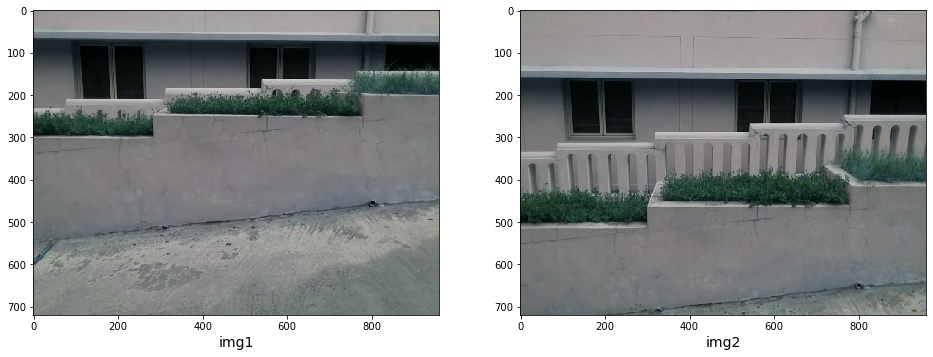

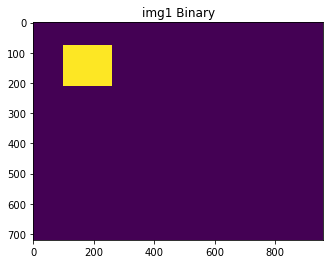

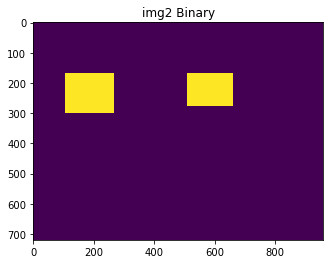

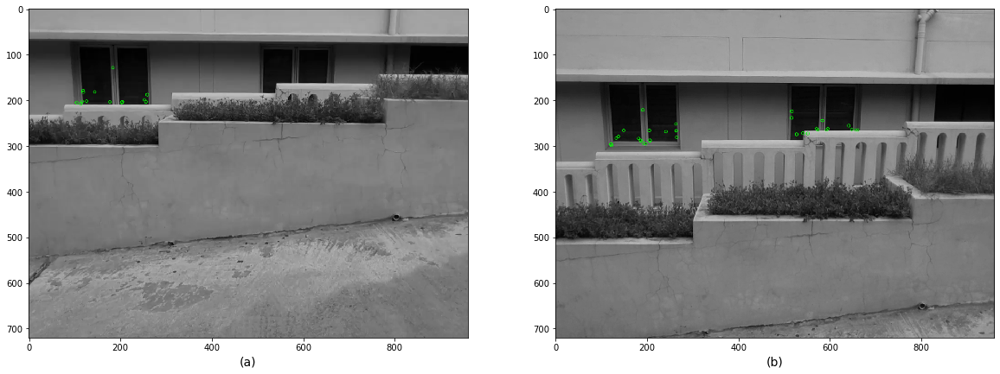

Using: bf feature matcher
Raw matches (Brute force): 12


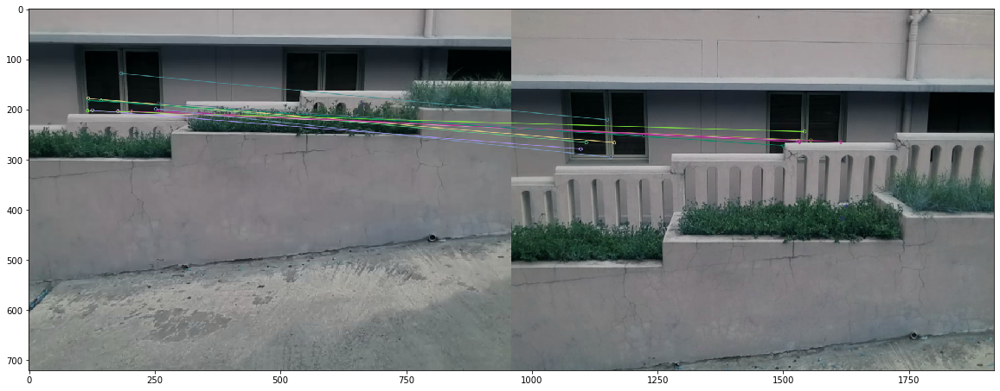

Final homography:  [[ 1.87082270e+00 -4.99362759e+00  6.35666348e+02]
 [ 8.58908938e-01 -2.14387190e+00  2.61508545e+02]
 [ 3.27714254e-03 -8.19082013e-03  1.00000000e+00]]
Final inliers count:  5
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


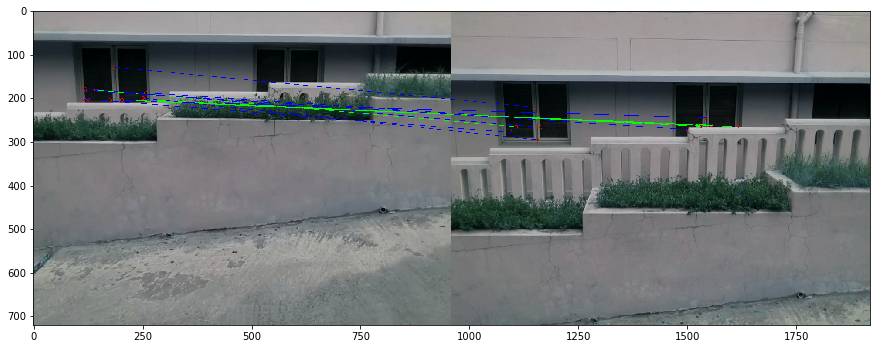

[[203.18609619140625, 204.8697509765625, 595.3079223632812, 261.67608642578125], [177.26199340820312, 203.6479034423828, 569.8310546875, 262.0730285644531], [255.909423828125, 203.30393981933594, 572.9803466796875, 264.83282470703125], [144.0937042236328, 181.7767791748047, 148.9586639404297, 265.7557373046875], [204.33224487304688, 203.76303100585938, 655.2300415039062, 265.02911376953125]]
pick1: [[100, 77, 262, 212]]
pick2: [[105, 167, 267, 300], [510, 167, 662, 277]]
box2:  [105, 167, 267, 300]
pointB:  (595, 262)
pointA:  (203, 205)
listA:  []
ElementA:  [100, 77, 262, 212]
count:  0
pointB:  (570, 262)
pointA:  (177, 204)
listA:  []
ElementA:  [100, 77, 262, 212]
count:  0
pointB:  (573, 265)
pointA:  (256, 203)
listA:  []
ElementA:  [100, 77, 262, 212]
count:  0
pointB:  (149, 266)
pointA:  (144, 182)
Inside DEBUG LOOP
insideBCounter:  1
listA:  []
ElementA:  [100, 77, 262, 212]
count:  0
##### OLD BOX #######
fINAL insideBCounter:  1
newCountInItr: 0
box2:  [510, 167, 662, 277]

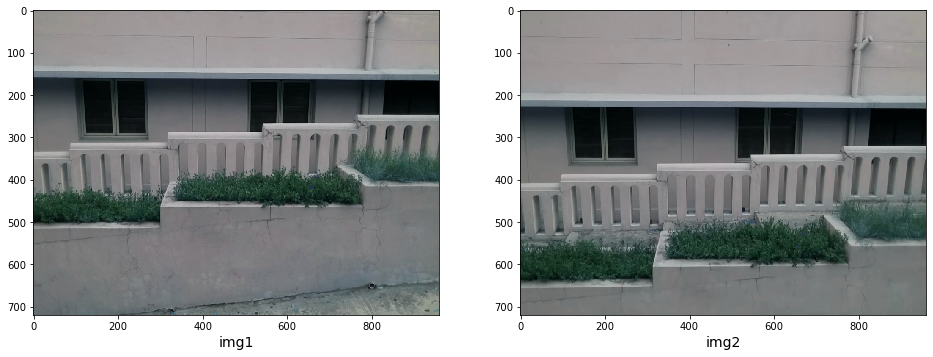

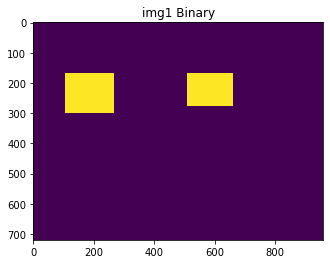

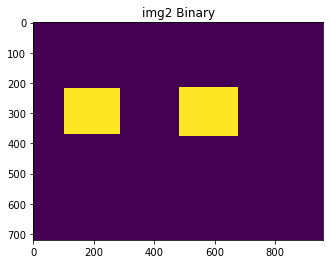

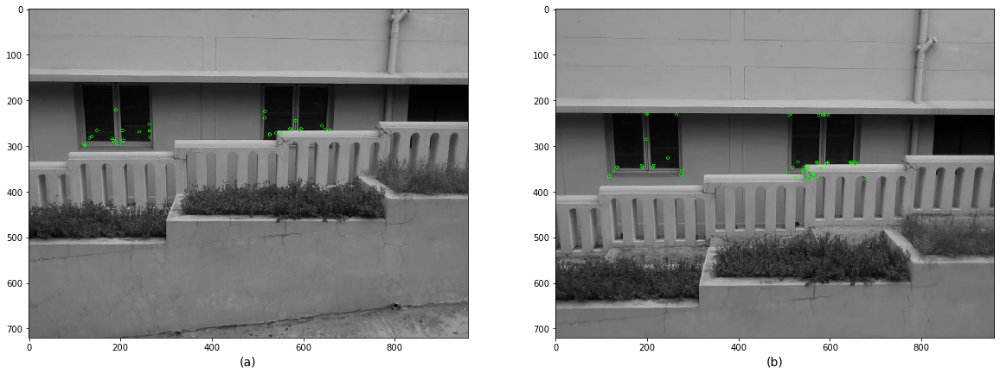

Using: bf feature matcher
Raw matches (Brute force): 25


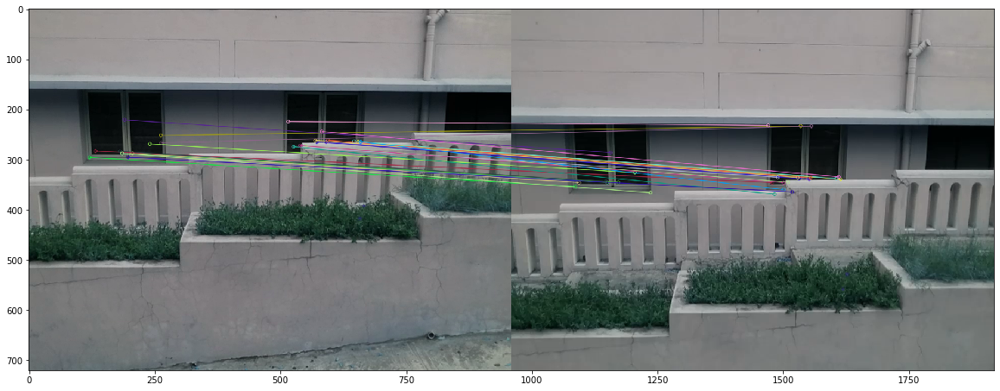

Final homography:  [[ 9.09691565e-01 -9.46943487e-03  2.09178912e+01]
 [ 1.61302541e-03  8.87486716e-01  8.29739904e+01]
 [-8.48885139e-05 -3.33946891e-05  1.00000000e+00]]
Final inliers count:  13
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


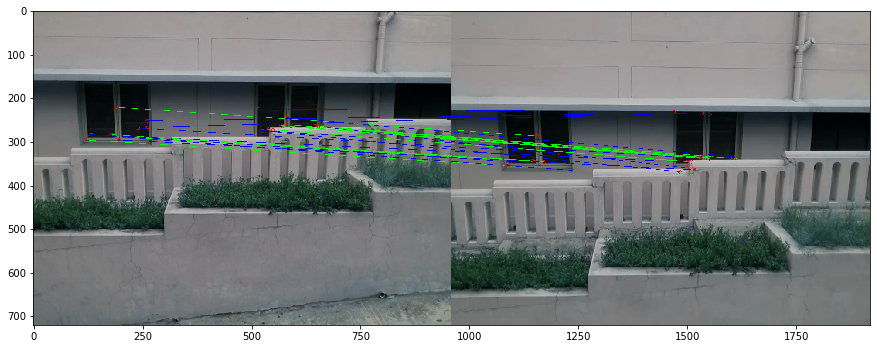

[[655.2300415039062, 265.02911376953125, 654.4539184570312, 338.8465881347656], [647.1331176757812, 263.79107666015625, 645.7976684570312, 337.55120849609375], [591.4510498046875, 264.87322998046875, 591.8629150390625, 338.7764587402344], [572.9803466796875, 264.83282470703125, 571.772705078125, 337.7766418457031], [120.9258804321289, 295.7054138183594, 126.976318359375, 354.0877685546875], [185.7525634765625, 287.78985595703125, 190.16114807128906, 345.5366516113281], [595.3079223632812, 261.67608642578125, 594.7255249023438, 336.2425231933594], [206.26580810546875, 287.6797180175781, 212.3005828857422, 345.2567138671875], [569.8310546875, 262.0730285644531, 569.3290405273438, 335.6533203125], [190.59983825683594, 220.86074829101562, 196.85040283203125, 286.0299377441406], [550.7571411132812, 272.554931640625, 550.0807495117188, 345.0224304199219], [181.44732666015625, 283.5609436035156, 187.9690399169922, 343.46600341796875], [540.0714111328125, 271.96160888671875, 540.8724975585938,

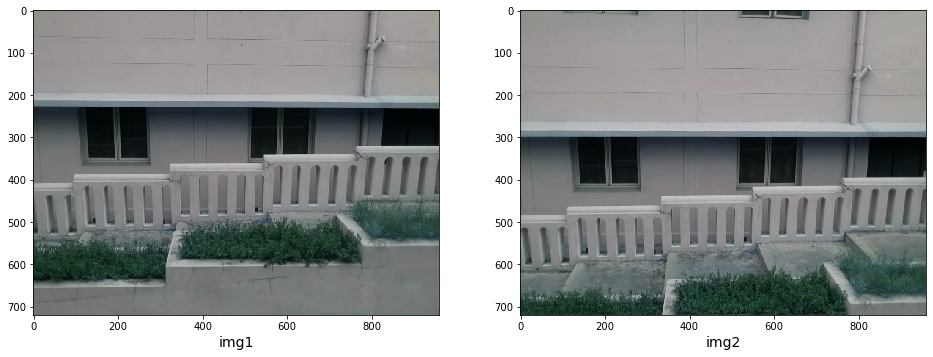

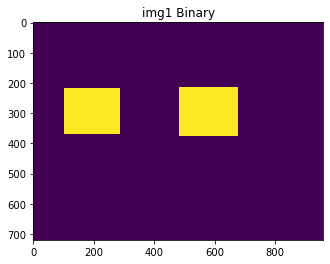

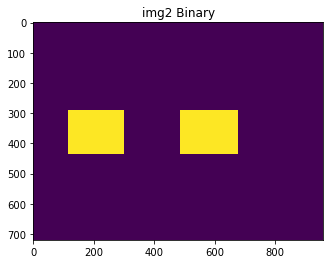

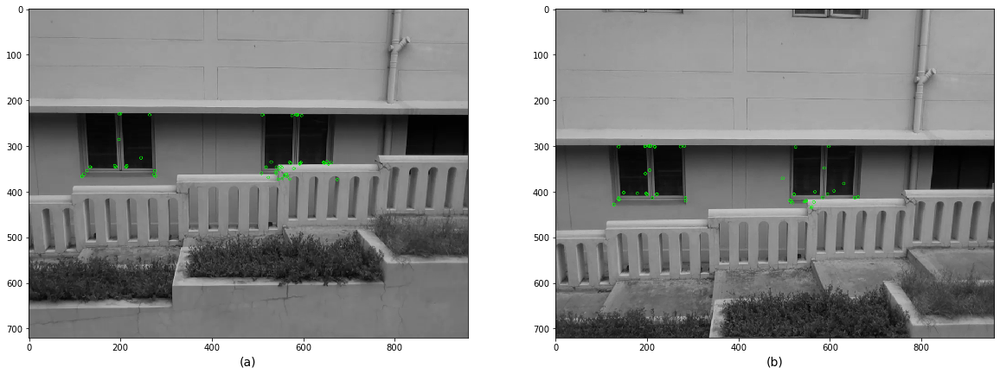

Using: bf feature matcher
Raw matches (Brute force): 32


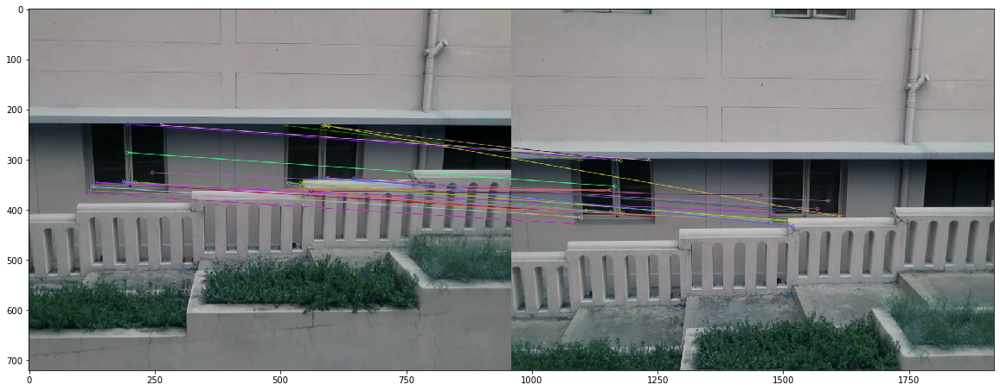

Final homography:  [[ 1.04212873e+00  9.86257440e-02 -8.22001474e+00]
 [-5.53598794e-02  1.14990408e+00  6.82658575e+01]
 [-1.42137965e-04  4.28323142e-04  1.00000000e+00]]
Final inliers count:  10
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


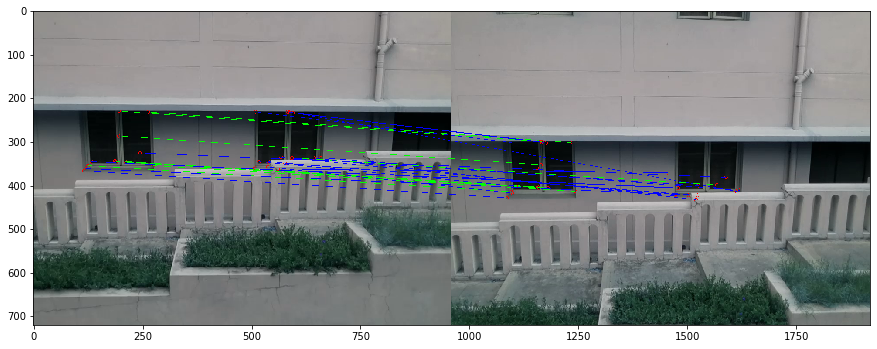

[[187.9690399169922, 343.46600341796875, 197.50662231445312, 403.6469421386719], [190.16114807128906, 345.5366516113281, 199.67312622070312, 405.75531005859375], [212.3005828857422, 345.2567138671875, 221.0561981201172, 405.76434326171875], [212.3005828857422, 345.2567138671875, 221.0561981201172, 405.76434326171875], [264.0592346191406, 231.46710205078125, 272.9743957519531, 301.2524108886719], [196.85040283203125, 286.0299377441406, 205.68890380859375, 352.9131774902344], [197.5944061279297, 229.5919952392578, 207.27294921875, 299.94366455078125], [126.976318359375, 354.0877685546875, 137.48587036132812, 414.49114990234375], [275.5894775390625, 354.30450439453125, 283.8442687988281, 413.9726867675781], [594.7255249023438, 336.2425231933594, 608.5232543945312, 398.2950439453125]]
pick1: [[483, 215, 678, 375], [104, 217, 289, 370]]
pick2: [[487, 290, 680, 437], [117, 290, 300, 435]]
box2:  [487, 290, 680, 437]
pointB:  (198, 404)
pointA:  (188, 343)
listA:  []
ElementA:  [104, 217, 289

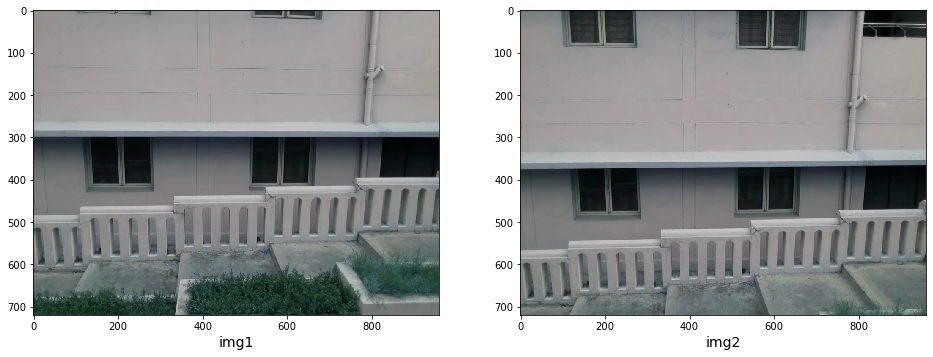

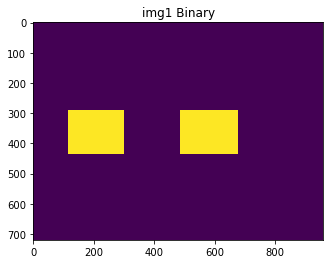

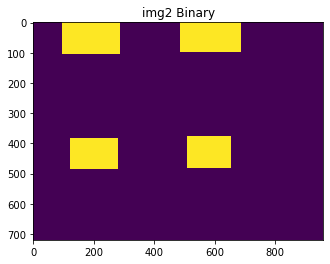

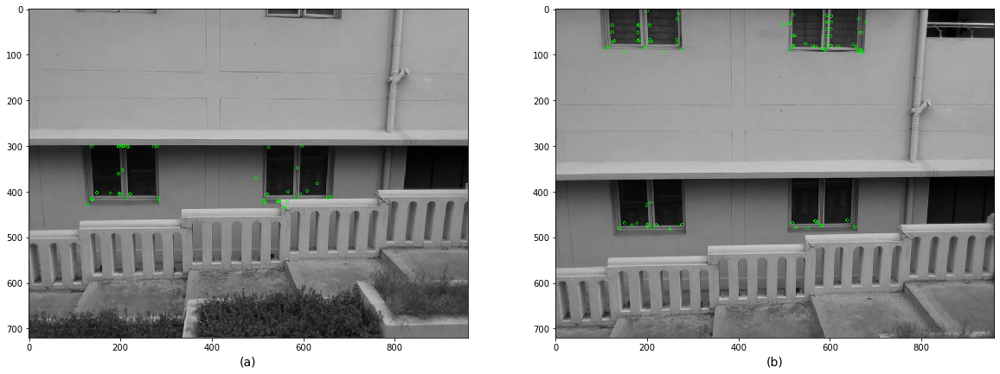

Using: bf feature matcher
Raw matches (Brute force): 31


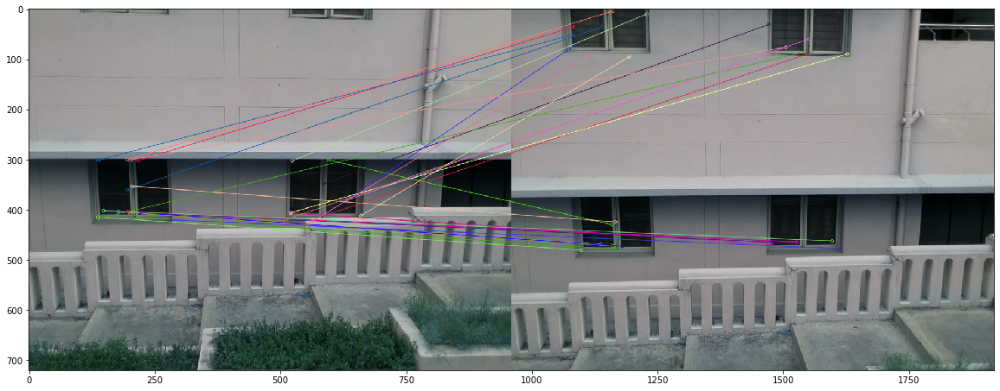

Final homography:  [[ 1.01173910e+00  5.04505615e-03 -8.38878682e-01]
 [ 2.48176224e-03  9.18033362e-01  1.03962469e+02]
 [ 2.97885441e-05  1.24080401e-05  1.00000000e+00]]
Final inliers count:  10
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


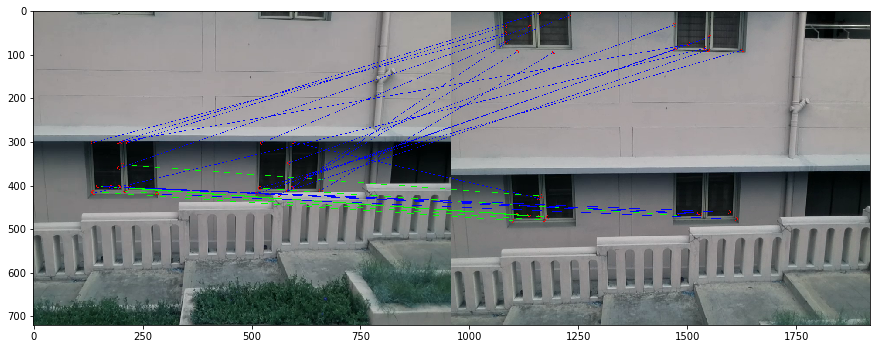

[[520.4878540039062, 406.1355285644531, 517.1830444335938, 468.475830078125], [520.4878540039062, 406.1355285644531, 517.1830444335938, 468.475830078125], [148.98956298828125, 401.77386474609375, 150.5483856201172, 467.4798583984375], [199.67312622070312, 405.75531005859375, 201.01759338378906, 471.77362060546875], [137.48587036132812, 414.49114990234375, 139.0673065185547, 480.3823547363281], [178.34974670410156, 403.3742370605469, 177.33132934570312, 468.4372253417969], [199.67312622070312, 405.75531005859375, 201.01759338378906, 471.77362060546875], [221.0561981201172, 405.76434326171875, 220.10162353515625, 472.367431640625], [211.4407501220703, 413.85675048828125, 212.3868865966797, 479.0557556152344], [205.68890380859375, 352.9131774902344, 206.87167358398438, 424.0043640136719]]
pick1: [[487, 290, 680, 437], [117, 290, 300, 435]]
pick2: [[122, 382, 282, 487], [510, 377, 657, 482], [97, 0, 287, 107], [488, 0, 688, 100]]
box2:  [122, 382, 282, 487]
pointB:  (517, 468)
pointA:  (52

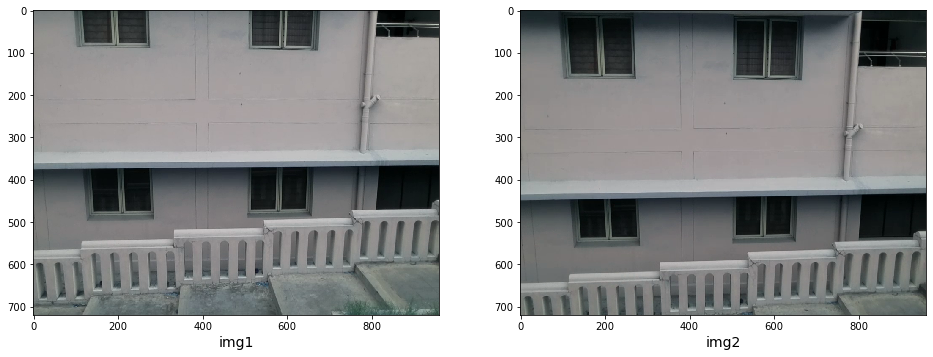

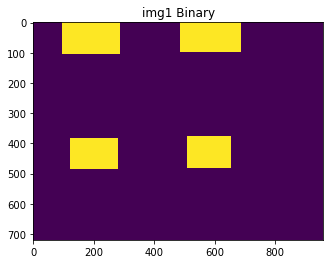

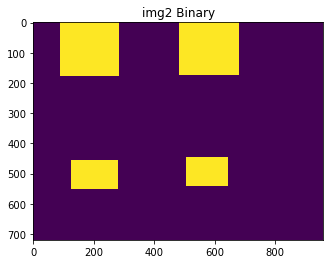

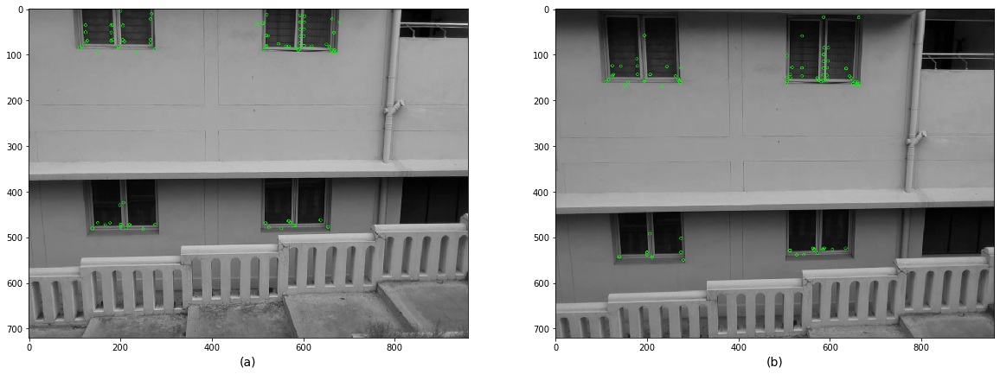

Using: bf feature matcher
Raw matches (Brute force): 60


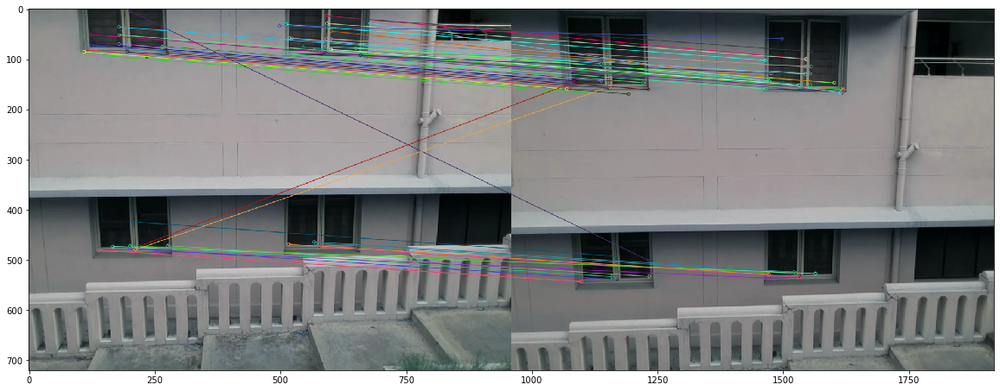

Final homography:  [[ 9.95116889e-01  3.93211357e-03 -8.45684997e-01]
 [-1.44061853e-03  9.77873181e-01  7.45915102e+01]
 [ 9.69693283e-06  2.62976632e-06  1.00000000e+00]]
Final inliers count:  44
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


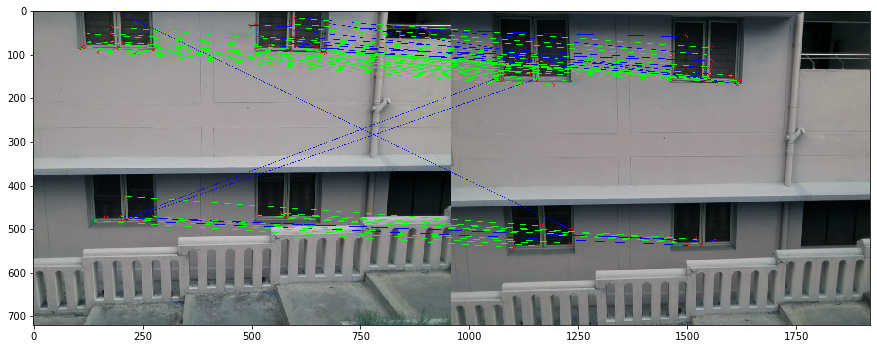

[[180.01177978515625, 51.91585922241211, 178.1631622314453, 124.7783203125], [179.52821350097656, 36.10738754272461, 177.7286834716797, 109.13055419921875], [545.3275146484375, 76.31364440917969, 538.6095581054688, 146.49423217773438], [650.412353515625, 77.69197082519531, 642.1702270507812, 147.18568420410156], [208.84002685546875, 71.06902313232422, 206.79656982421875, 143.46978759765625], [600.9815063476562, 59.51681900024414, 593.5824584960938, 128.89584350585938], [234.69384765625, 94.73030853271484, 233.0159149169922, 169.5660400390625], [150.83091735839844, 93.5670166015625, 151.39810180664062, 168.29600524902344], [208.84002685546875, 71.06902313232422, 206.79656982421875, 143.46978759765625], [522.8770141601562, 58.81528854370117, 516.4205322265625, 128.13790893554688], [668.138427734375, 89.72223663330078, 659.9514770507812, 160.2896270751953], [517.1830444335938, 468.475830078125, 512.0198974609375, 528.7327270507812], [517.1830444335938, 468.475830078125, 512.0198974609375,

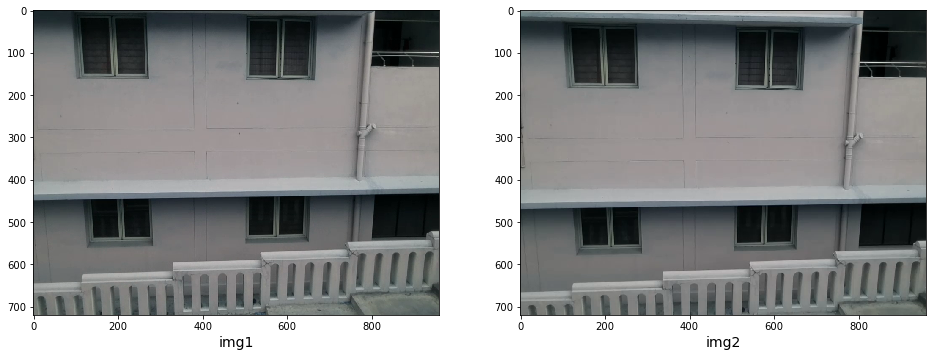

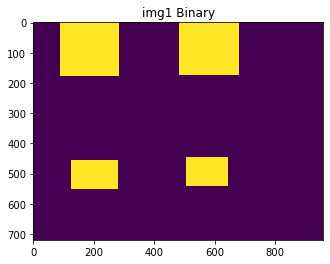

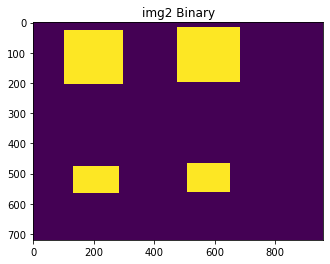

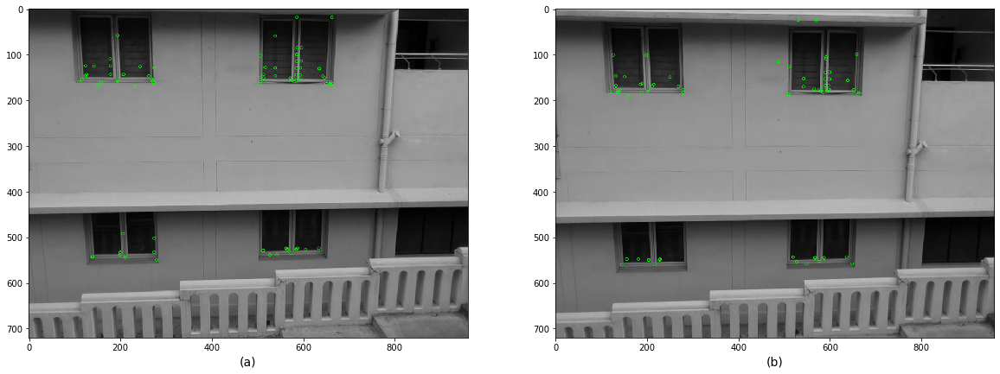

Using: bf feature matcher
Raw matches (Brute force): 64


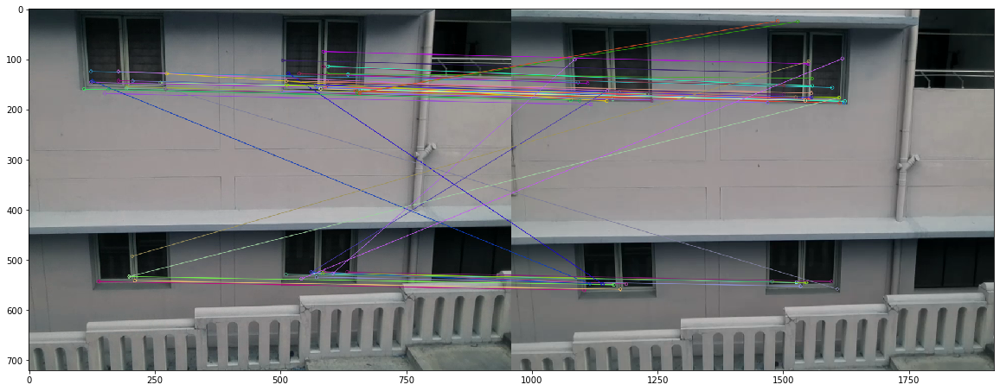

Final homography:  [[ 9.99988754e-01 -7.86506900e-03  8.97111784e+00]
 [ 6.86575978e-03  9.82107634e-01  2.39276769e+01]
 [ 1.55274927e-05 -1.19257183e-05  1.00000000e+00]]
Final inliers count:  40
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


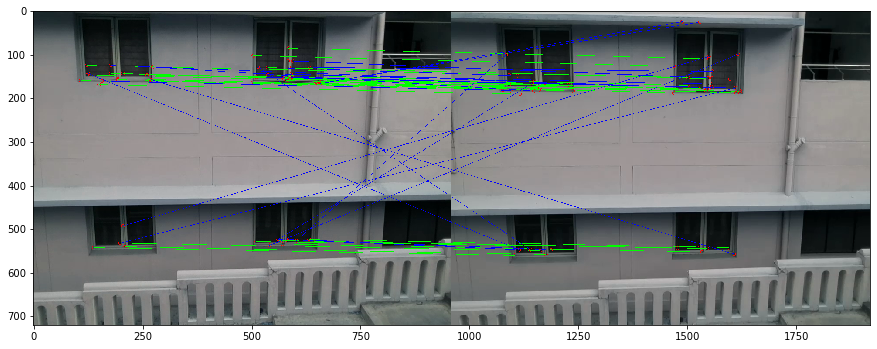

[[586.2978515625, 85.07711791992188, 590.2805786132812, 109.44924926757812], [538.6095581054688, 146.49423217773438, 541.518310546875, 170.14340209960938], [123.79573059082031, 124.4950180053711, 132.21934509277344, 146.6971435546875], [206.79656982421875, 143.46978759765625, 214.40223693847656, 165.7004852294922], [564.75244140625, 526.5711059570312, 566.8308715820312, 544.69775390625], [178.4308624267578, 143.036865234375, 185.7257537841797, 165.32879638671875], [659.9514770507812, 160.2896270751953, 662.689208984375, 184.14932250976562], [124.23102569580078, 146.06106567382812, 132.29275512695312, 168.17822265625], [564.75244140625, 526.5711059570312, 566.8308715820312, 544.69775390625], [261.6625671386719, 146.84219360351562, 268.5735778808594, 169.5495147705078], [151.39810180664062, 168.29600524902344, 157.96717834472656, 190.71182250976562], [659.9514770507812, 160.2896270751953, 662.689208984375, 184.14932250976562], [124.23102569580078, 146.06106567382812, 132.29275512695312, 

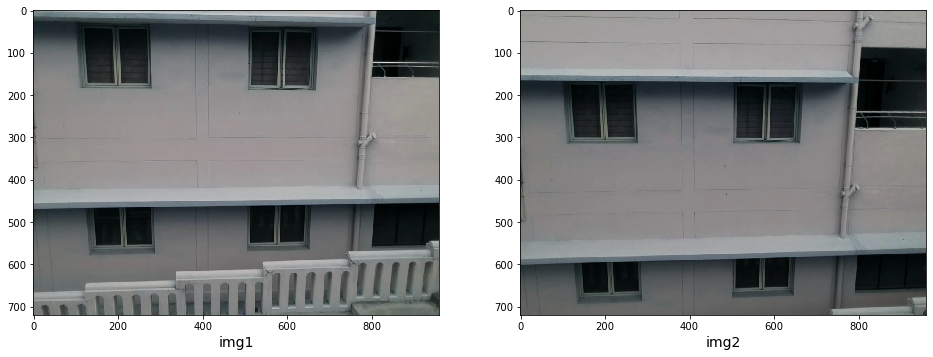

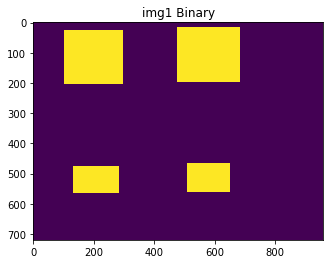

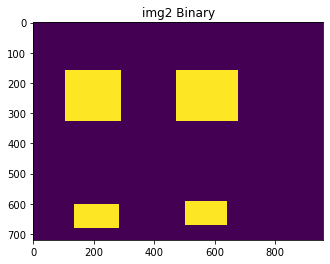

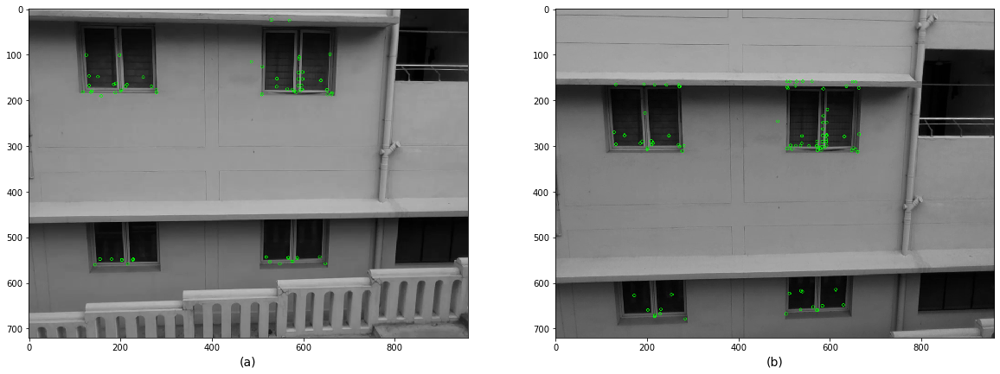

Using: bf feature matcher
Raw matches (Brute force): 53


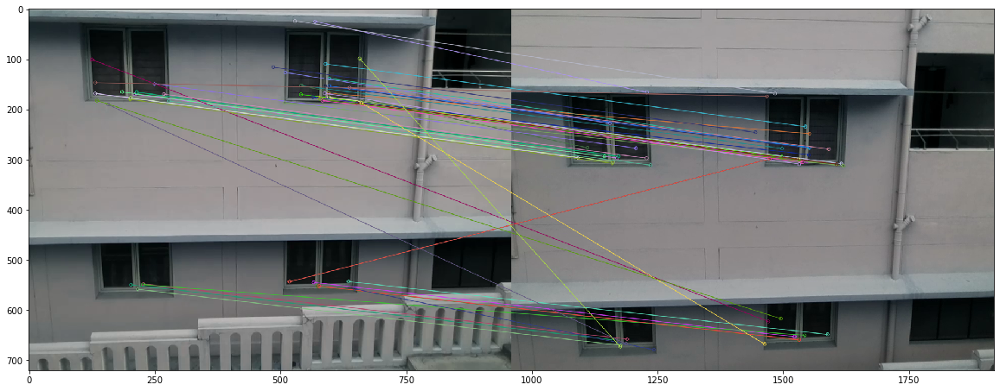

Final homography:  [[ 9.86831195e-01 -3.24824703e-03  1.78187391e+00]
 [-6.62443596e-03  9.45682924e-01  1.37656176e+02]
 [-6.02877057e-07 -7.68462612e-06  1.00000000e+00]]
Final inliers count:  32
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


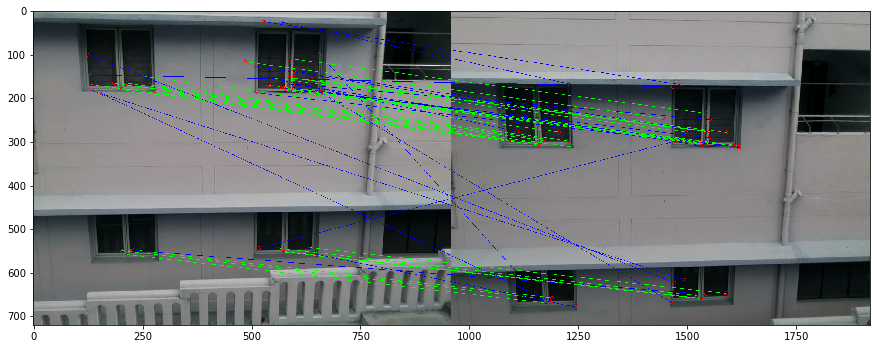

[[541.518310546875, 170.14340209960938, 537.42578125, 294.0042419433594], [588.93603515625, 153.54534912109375, 583.4594116210938, 276.72003173828125], [590.2805786132812, 109.44924926757812, 584.823486328125, 234.375732421875], [662.689208984375, 184.14932250976562, 655.9114990234375, 308.07940673828125], [214.40223693847656, 165.7004852294922, 212.81094360351562, 293.2512512207031], [592.7300415039062, 178.81344604492188, 587.1421508789062, 303.3557434082031], [575.94287109375, 176.00958251953125, 570.474609375, 299.78118896484375], [574.6741943359375, 552.2108764648438, 570.1978149414062, 659.0765380859375], [211.2761993408203, 169.80812072753906, 209.95199584960938, 296.8677673339844], [597.998046875, 153.4939727783203, 592.9881591796875, 276.2586975097656], [542.2826538085938, 152.64251708984375, 538.0372924804688, 277.883056640625], [228.16024780273438, 547.7221069335938, 230.1228790283203, 657.4396362304688], [486.40283203125, 116.14544677734375, 485.146484375, 245.8577270507812

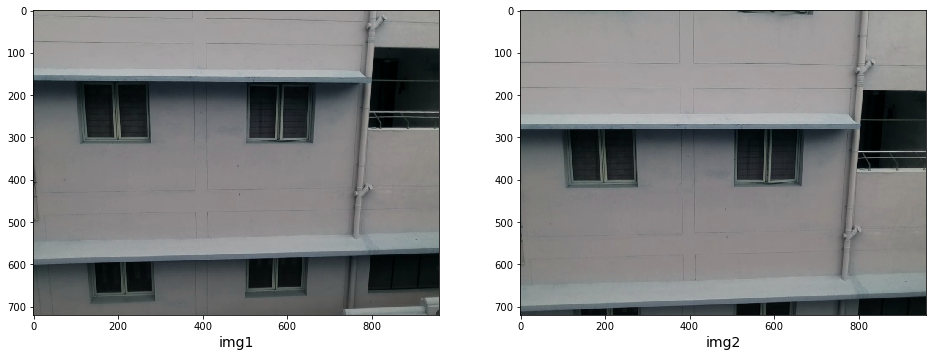

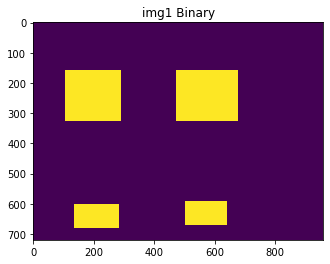

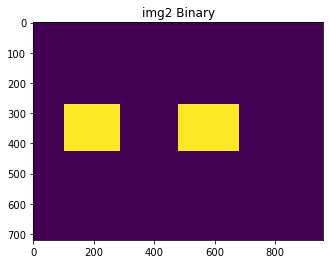

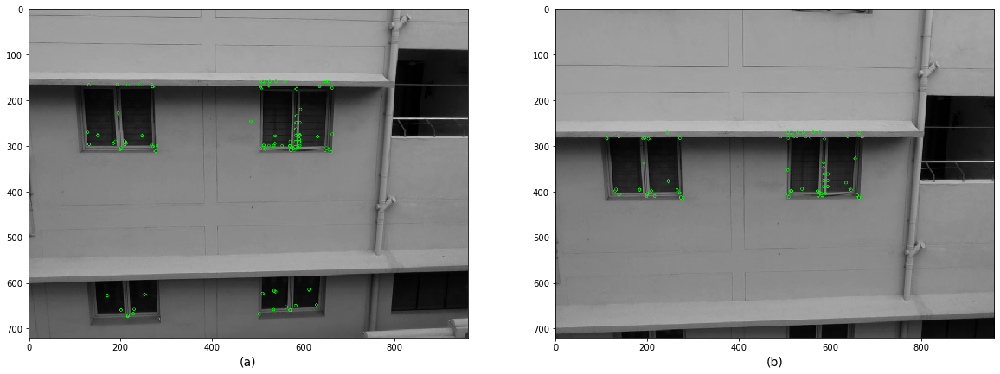

Using: bf feature matcher
Raw matches (Brute force): 50


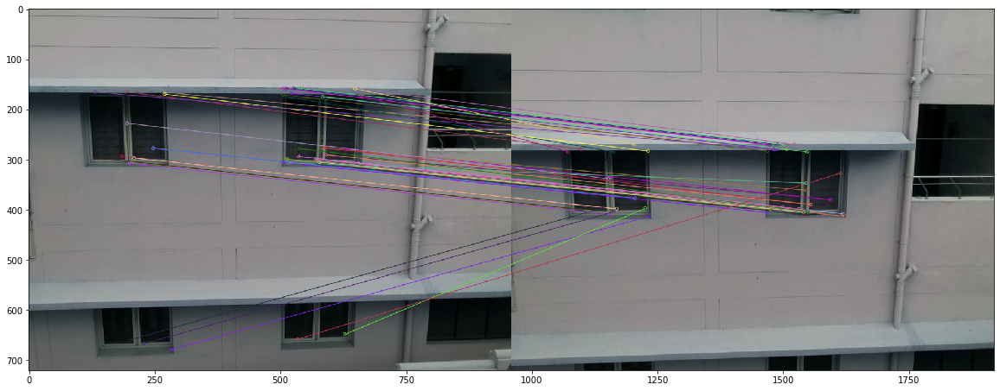

Final homography:  [[ 9.61139007e-01 -2.38874173e-02  8.91884033e+00]
 [-2.66793875e-02  8.66375434e-01  1.38671819e+02]
 [-4.68622897e-05 -4.44437606e-05  1.00000000e+00]]
Final inliers count:  33
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


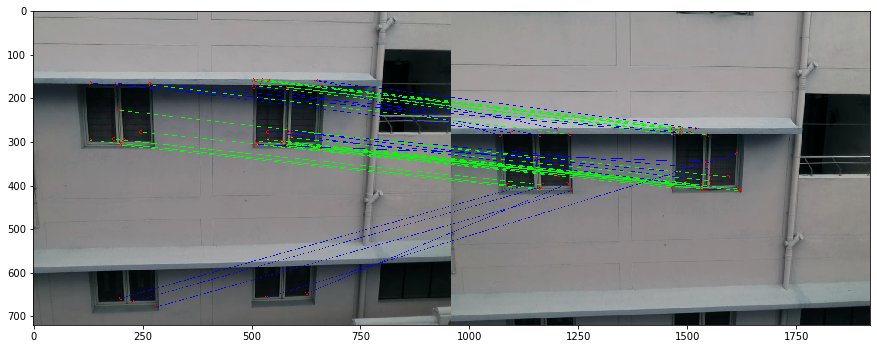

[[185.31011962890625, 293.7530517578125, 183.93272399902344, 395.8939514160156], [580.3129272460938, 308.4742736816406, 582.6869506835938, 408.5032653808594], [655.9114990234375, 308.07940673828125, 659.1139526367188, 408.19757080078125], [630.8546752929688, 278.9972839355469, 634.5827026367188, 380.0066223144531], [513.164306640625, 298.7704772949219, 514.6292724609375, 398.4012451171875], [511.6089782714844, 158.5683135986328, 513.83740234375, 270.4735107421875], [572.2868041992188, 308.9417724609375, 574.517333984375, 408.459228515625], [660.1202392578125, 312.67364501953125, 662.9476318359375, 412.8187255859375], [513.164306640625, 298.7704772949219, 514.6292724609375, 398.4012451171875], [526.6788330078125, 158.2292022705078, 528.8858642578125, 270.14947509765625], [537.42578125, 294.0042419433594, 538.3170166015625, 393.7978820800781], [539.9947509765625, 158.04273986816406, 541.6653442382812, 269.9156494140625], [209.95199584960938, 296.8677673339844, 209.32528686523438, 398.148

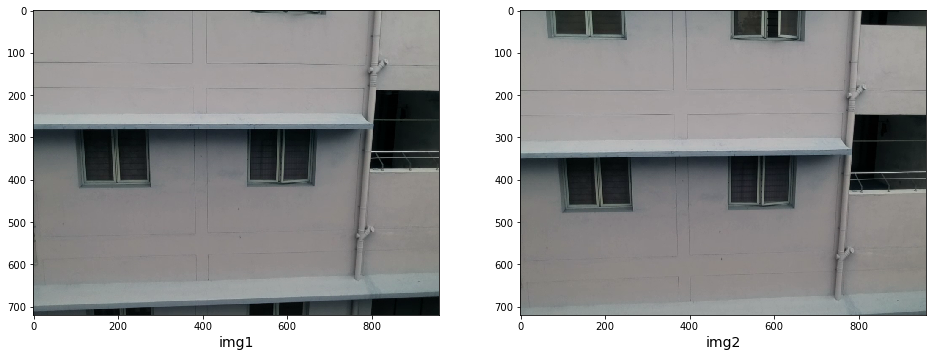

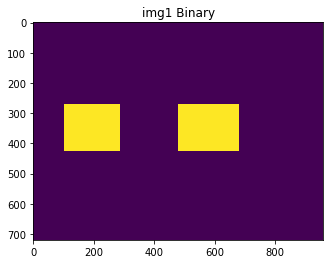

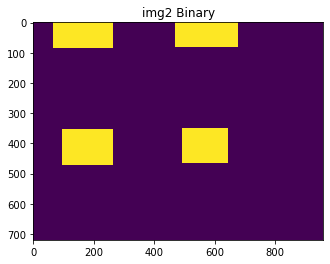

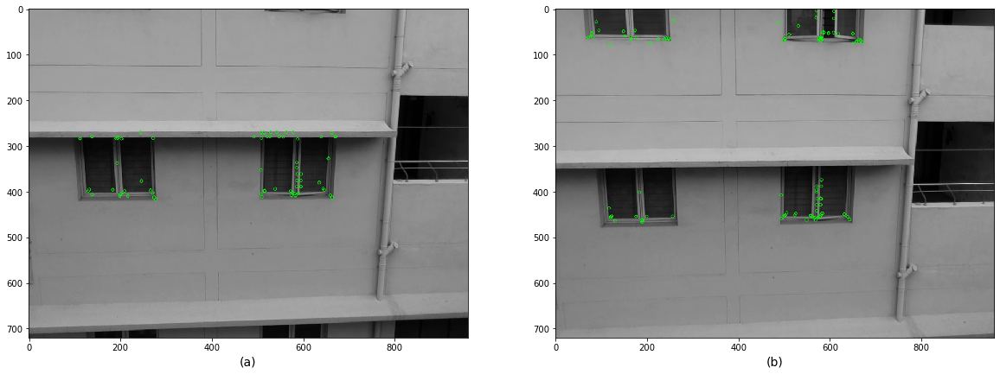

Using: bf feature matcher
Raw matches (Brute force): 54


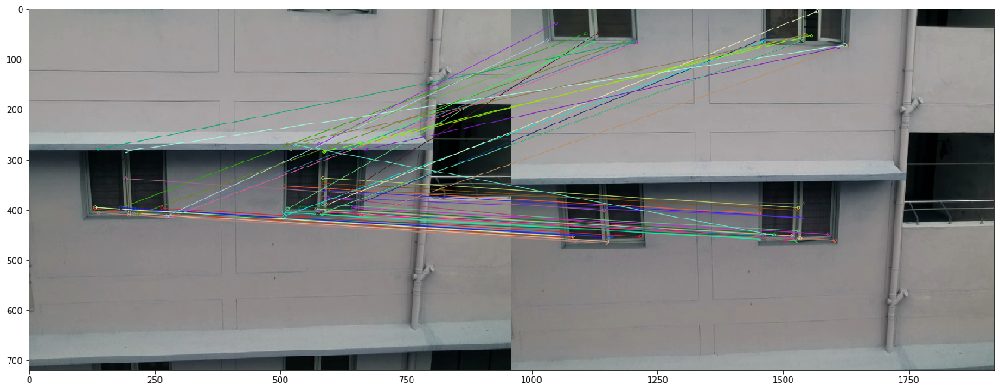

Final homography:  [[ 9.91786935e-01  1.60712885e-02 -1.41433989e+01]
 [-1.07229082e-02  9.71269696e-01  7.19941192e+01]
 [ 1.89027423e-06  7.90799794e-06  1.00000000e+00]]
Final inliers count:  27
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


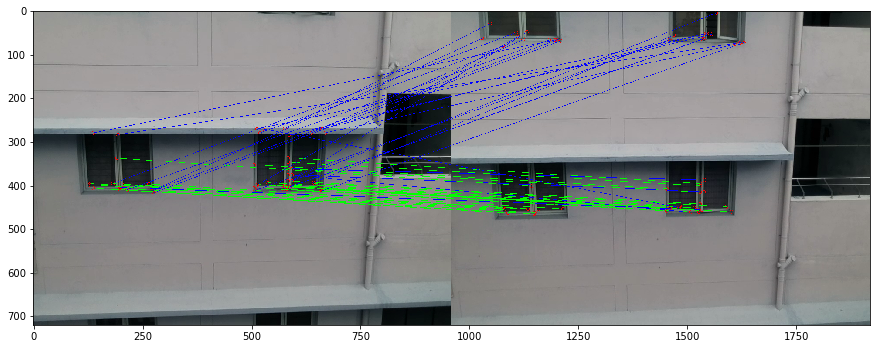

[[586.3024291992188, 361.4094543457031, 570.8876953125, 415.0869445800781], [585.6087646484375, 346.7355651855469, 570.0341796875, 400.9452209472656], [209.32528686523438, 398.1489562988281, 199.39154052734375, 454.1147155761719], [515.2655639648438, 397.8299865722656, 501.3515625, 451.19842529296875], [515.2655639648438, 397.8299865722656, 501.3515625, 451.19842529296875], [507.35546875, 352.58642578125, 493.034423828125, 407.4633483886719], [571.923828125, 398.5688171386719, 557.1424560546875, 451.8117980957031], [571.923828125, 398.5688171386719, 557.1424560546875, 451.8117980957031], [538.3170166015625, 393.7978820800781, 524.7660522460938, 447.5078125], [585.3999633789062, 389.2813415527344, 570.2172241210938, 442.0072021484375], [582.6869506835938, 408.5032653808594, 567.814453125, 461.5194091796875], [199.09536743164062, 409.38360595703125, 189.21234130859375, 465.7978515625], [576.8997192382812, 402.1318054199219, 561.705078125, 455.69390869140625], [132.31028747558594, 395.424

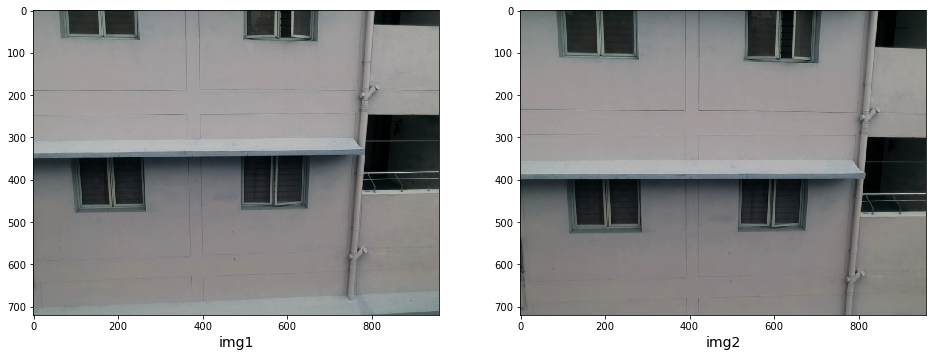

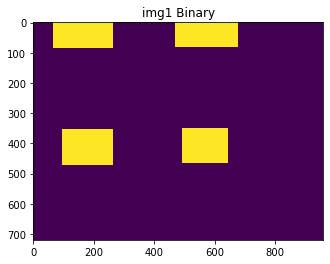

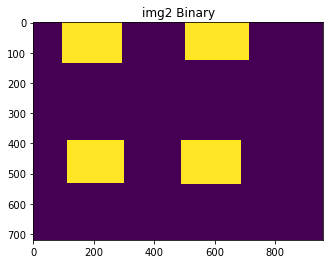

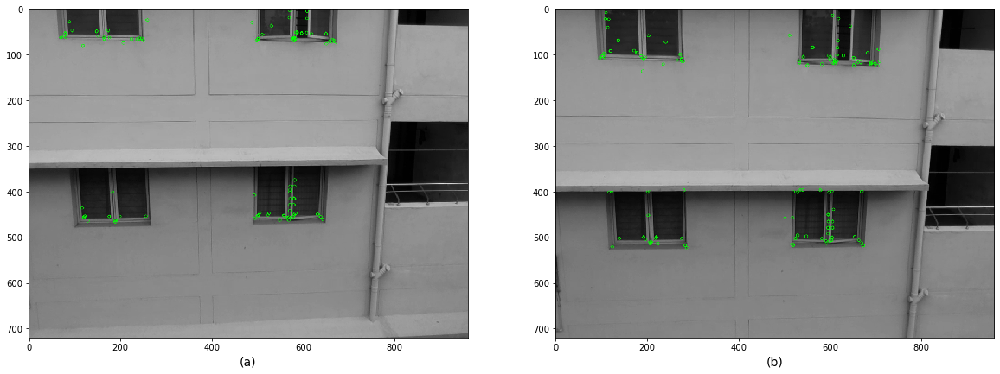

Using: bf feature matcher
Raw matches (Brute force): 81


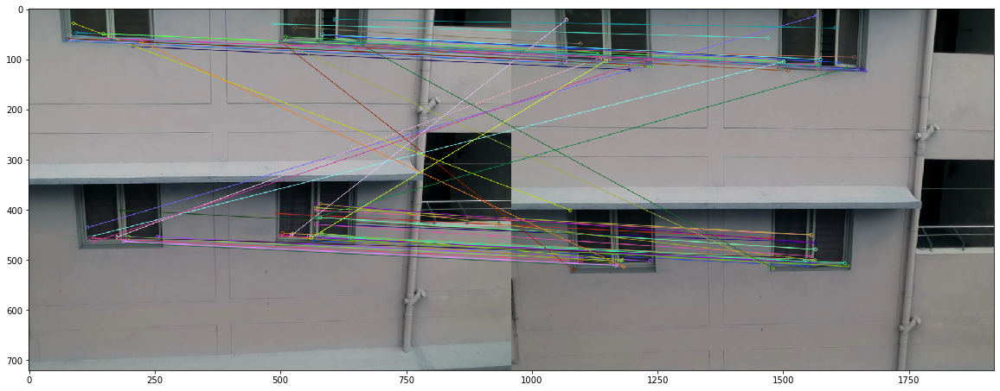

Final homography:  [[ 1.02576894e+00 -2.93515679e-02  2.47666122e+01]
 [ 1.64881094e-02  9.97168163e-01  4.28249588e+01]
 [ 1.56063327e-05 -1.43824128e-05  1.00000000e+00]]
Final inliers count:  50
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


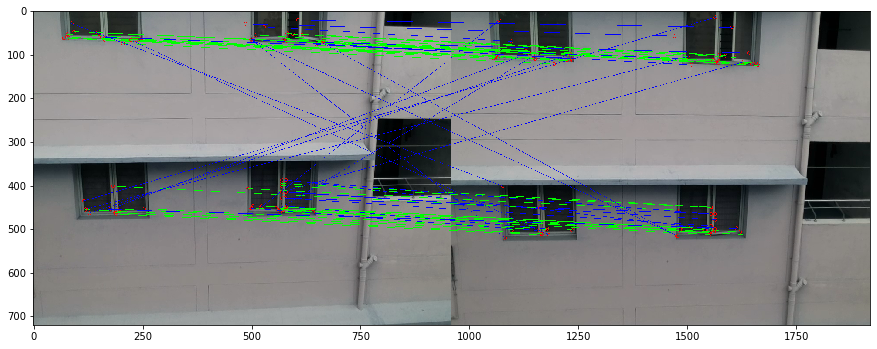

[[524.7660522460938, 447.5078125, 547.8233642578125, 497.7143859863281], [94.81329345703125, 47.21083068847656, 120.5409164428711, 91.3922119140625], [255.78941345214844, 453.73712158203125, 275.8043518066406, 501.76385498046875], [206.7410888671875, 74.57133483886719, 235.28933715820312, 121.14683532714844], [570.0341796875, 400.9452209472656, 595.8568115234375, 450.623291015625], [70.75153350830078, 62.7315788269043, 96.95662689208984, 108.00659942626953], [190.13681030273438, 462.82489013671875, 208.96910095214844, 510.4530944824219], [596.31103515625, 53.04030227661133, 628.905029296875, 102.33846282958984], [574.3146362304688, 456.8083190917969, 599.0313110351562, 508.01025390625], [504.92596435546875, 446.17620849609375, 528.8343505859375, 495.3382873535156], [79.6661605834961, 53.30765914916992, 105.65030670166016, 97.9953842163086], [79.6661605834961, 53.30765914916992, 105.65030670166016, 97.9953842163086], [567.814453125, 461.5194091796875, 591.9992065429688, 512.343994140625

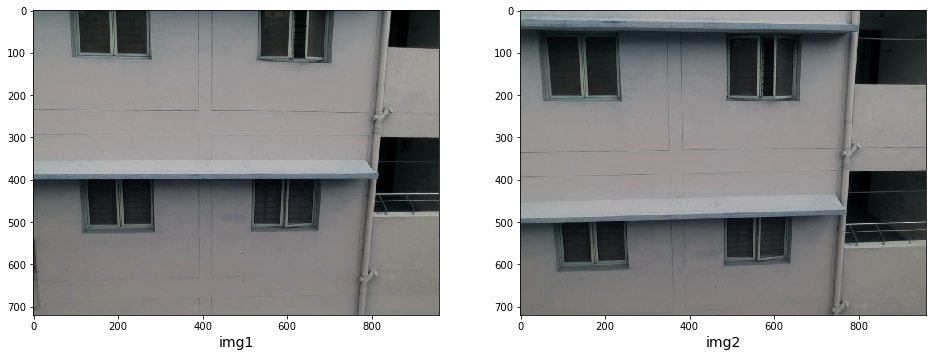

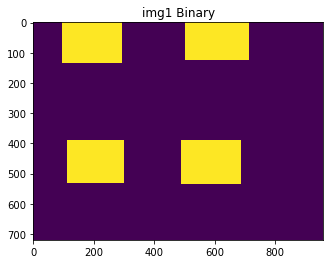

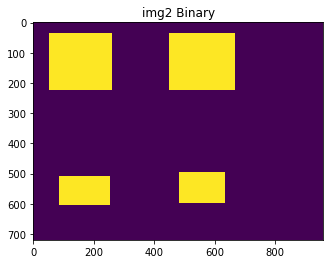

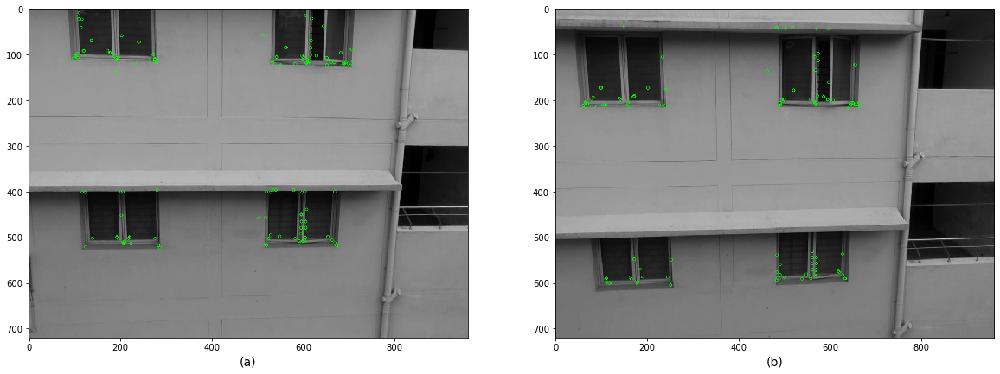

Using: bf feature matcher
Raw matches (Brute force): 83


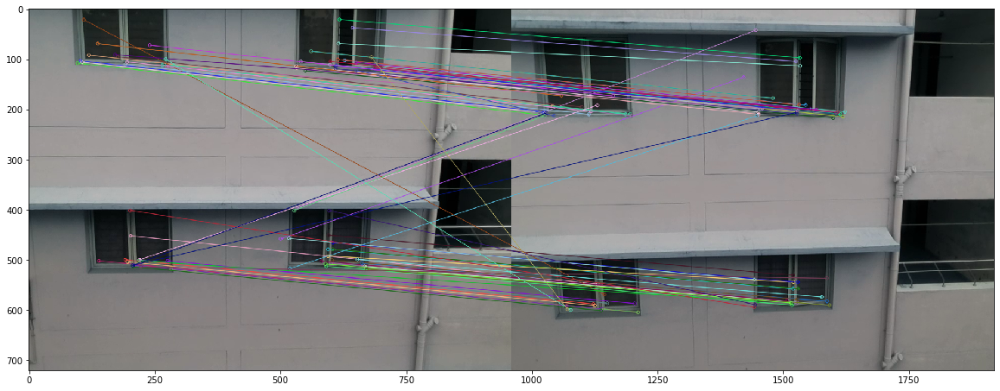

Final homography:  [[ 1.02479396e+00  3.66673369e-02 -4.70887497e+01]
 [-1.26281441e-02  1.00325139e+00  1.04276898e+02]
 [ 3.57238973e-05  3.00857294e-05  1.00000000e+00]]
Final inliers count:  59
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


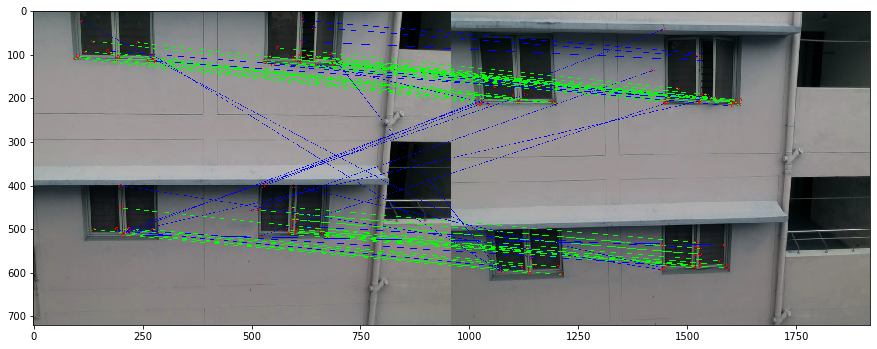

[[595.2445678710938, 478.8453369140625, 560.1663818359375, 557.3416137695312], [604.7278442382812, 478.8982849121094, 569.6105346679688, 557.1256713867188], [698.0802612304688, 119.65337371826172, 653.958251953125, 209.70985412597656], [177.04287719726562, 95.3724365234375, 139.18272399902344, 195.4384307861328], [220.26011657714844, 499.4803466796875, 190.54095458984375, 586.0272827148438], [605.0798950195312, 478.9809875488281, 570.1024169921875, 557.1460571289062], [139.18153381347656, 501.7146911621094, 109.58815002441406, 590.5537719726562], [595.8568115234375, 450.623291015625, 560.29736328125, 530.2780151367188], [275.3133544921875, 111.14727783203125, 236.01568603515625, 209.5471954345703], [283.2029113769531, 517.7645263671875, 251.73345947265625, 604.0108032226562], [602.6217041015625, 506.2848815917969, 568.2816162109375, 584.6865844726562], [119.74984741210938, 92.0140609741211, 82.14891052246094, 193.34771728515625], [602.6217041015625, 506.2848815917969, 568.2816162109375

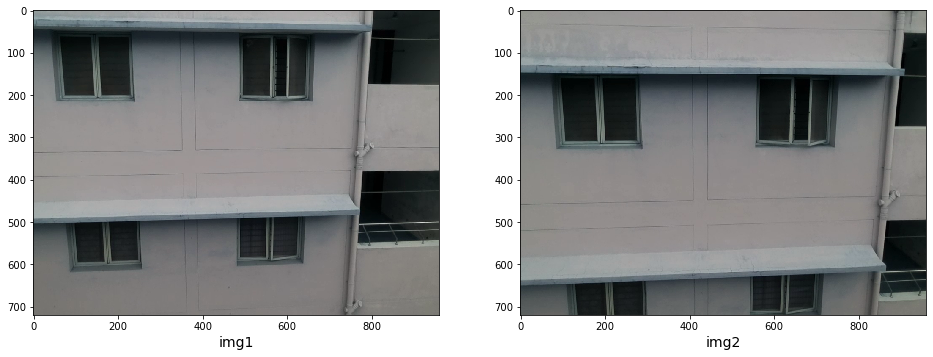

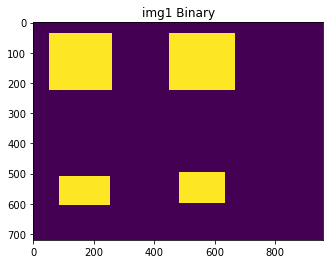

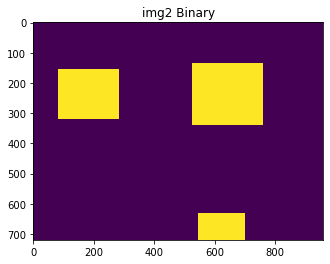

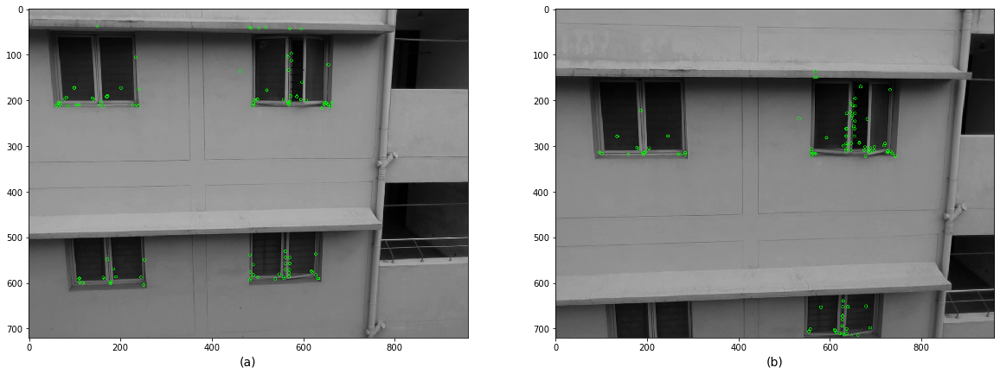

Using: bf feature matcher
Raw matches (Brute force): 68


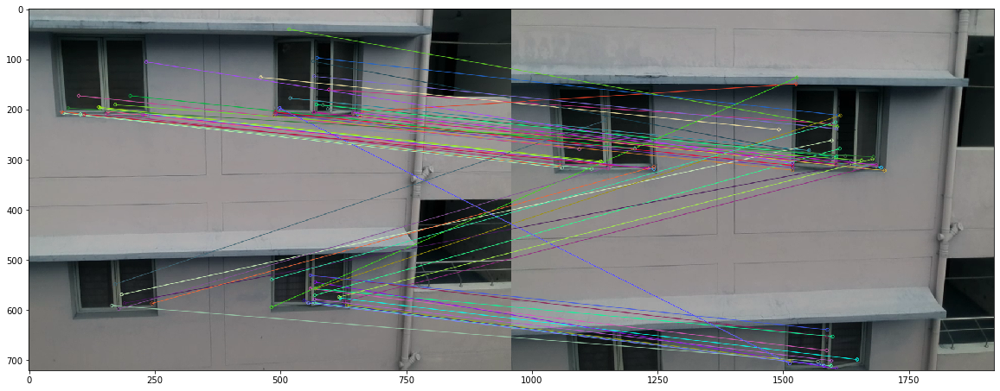

Final homography:  [[1.13983138e+00 2.04623505e-03 2.12340019e+01]
 [1.13704662e-02 1.12067524e+00 8.76032140e+01]
 [4.94522493e-05 4.54481746e-05 1.00000000e+00]]
Final inliers count:  39
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


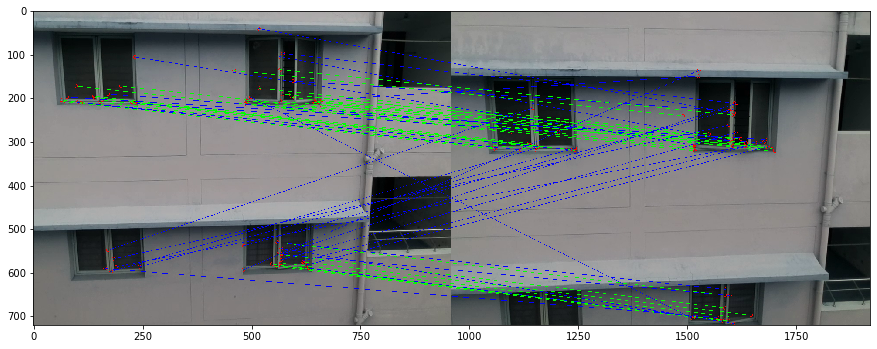

[[236.01568603515625, 209.5471954345703, 283.5513000488281, 319.08551025390625], [560.1663818359375, 557.3416137695312, 626.6589965820312, 680.0247802734375], [560.29736328125, 530.2780151367188, 627.6655883789062, 651.9031982421875], [461.6402282714844, 136.31263732910156, 531.7452392578125, 240.1979522705078], [141.6130828857422, 198.01976013183594, 179.91717529296875, 306.0208435058594], [653.958251953125, 209.70985412597656, 735.1737670898438, 315.58843994140625], [139.18272399902344, 195.4384307861328, 177.48072814941406, 303.42523193359375], [585.2825317382812, 191.48342895507812, 663.7426147460938, 293.0736083984375], [201.82347106933594, 172.97300720214844, 245.18435668945312, 277.9166259765625], [585.2825317382812, 191.48342895507812, 663.7426147460938, 293.0736083984375], [619.139892578125, 575.5906982421875, 687.3760375976562, 697.9697265625], [519.860107421875, 177.81173706054688, 591.9739379882812, 281.8294677734375], [659.3810424804688, 214.34536743164062, 741.83929443359

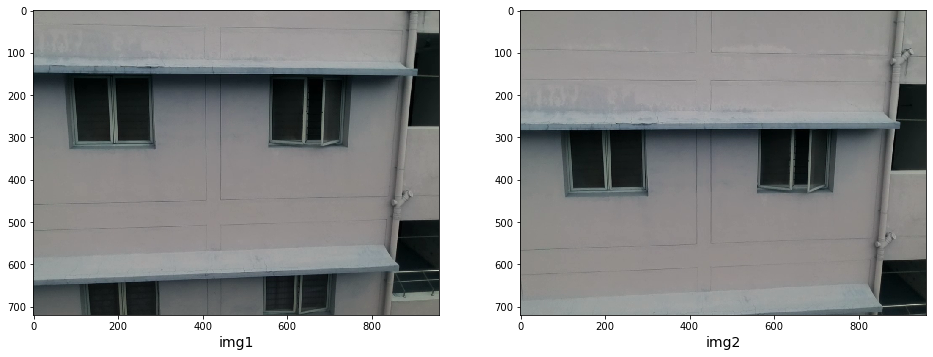

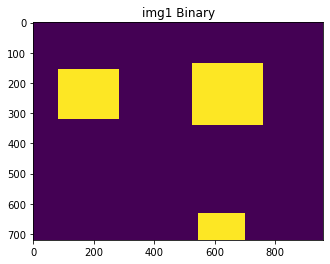

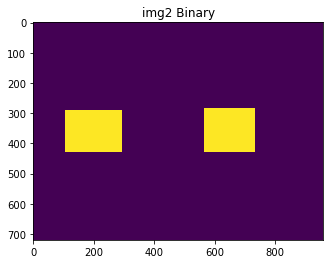

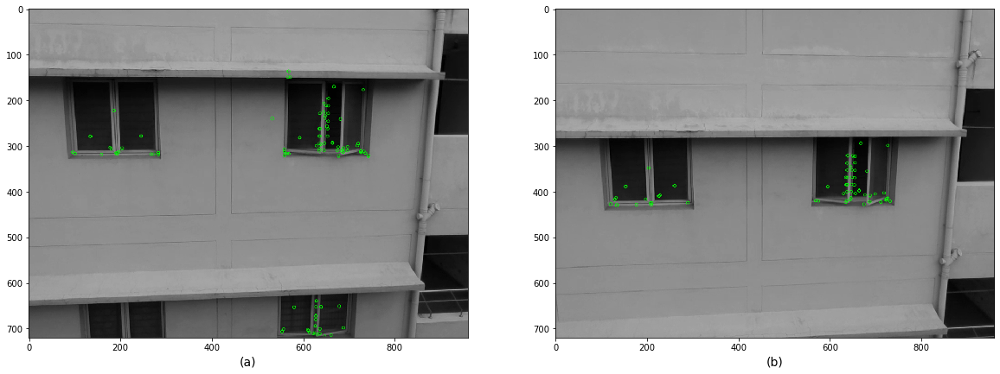

Using: bf feature matcher
Raw matches (Brute force): 56


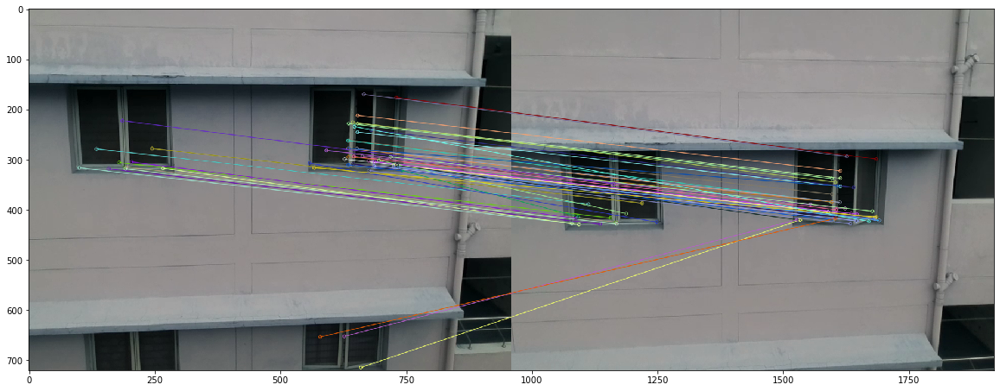

Final homography:  [[ 9.20673233e-01 -1.14438247e-01  5.65329823e+01]
 [-3.31726168e-03  8.38630280e-01  1.37188386e+02]
 [ 1.63824888e-05 -1.89624366e-04  1.00000000e+00]]
Final inliers count:  37
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


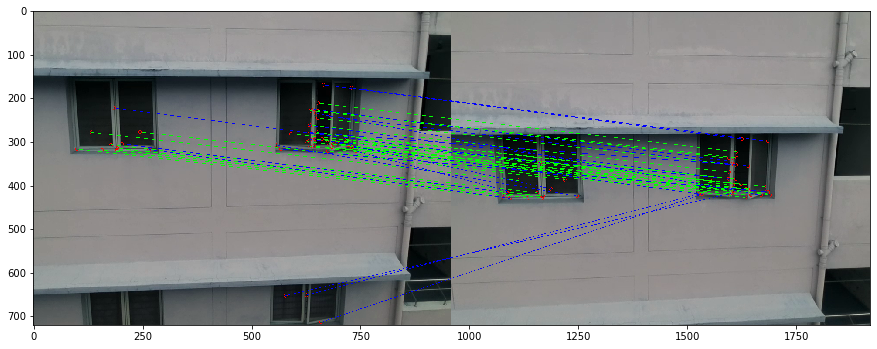

[[653.8906860351562, 245.48782348632812, 653.8997192382812, 353.3365783691406], [653.9871826171875, 228.2838134765625, 654.0355224609375, 336.94854736328125], [735.1737670898438, 315.58843994140625, 731.2479248046875, 421.24224853515625], [735.1737670898438, 315.58843994140625, 731.2479248046875, 421.24224853515625], [636.4713134765625, 261.8330383300781, 637.404541015625, 369.062744140625], [636.0106201171875, 228.43893432617188, 636.9016723632812, 337.7662658691406], [635.0139770507812, 278.02471923828125, 636.2823486328125, 384.5133361816406], [663.7426147460938, 293.0736083984375, 663.4976196289062, 397.5752258300781], [663.7426147460938, 293.0736083984375, 663.4976196289062, 397.5752258300781], [179.91717529296875, 306.0208435058594, 196.56704711914062, 416.08782958984375], [654.2459716796875, 211.98086547851562, 653.9584350585938, 322.3542785644531], [663.7426147460938, 293.0736083984375, 663.4976196289062, 397.5752258300781], [591.9739379882812, 281.8294677734375, 594.3917846679

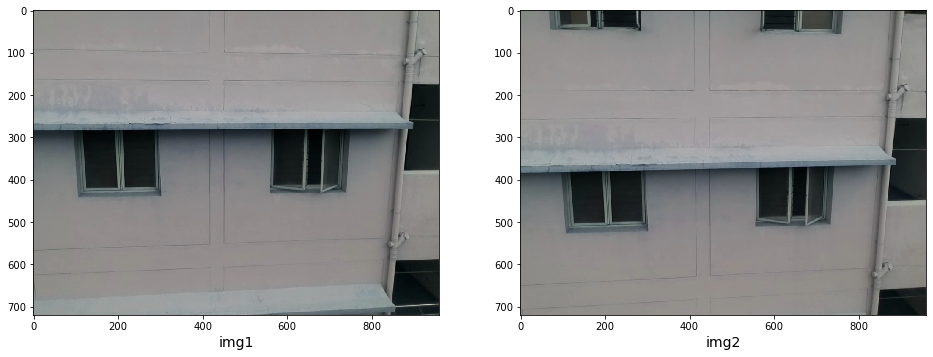

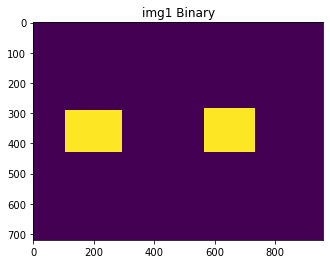

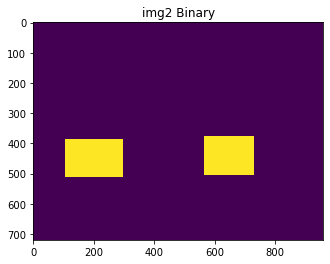

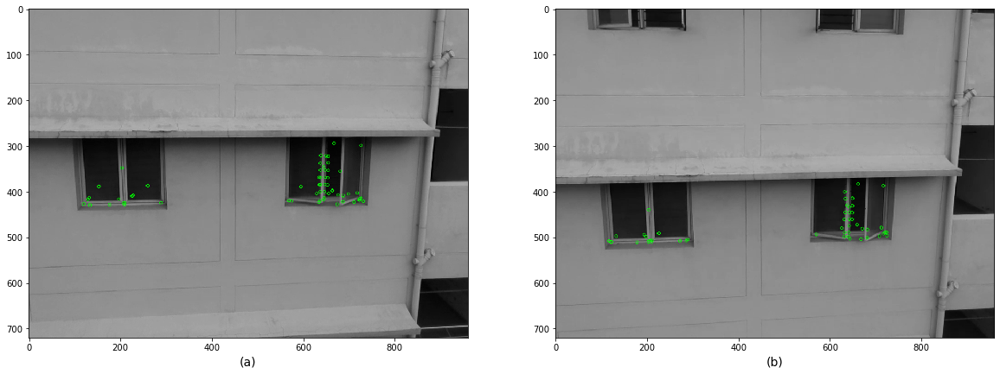

Using: bf feature matcher
Raw matches (Brute force): 44


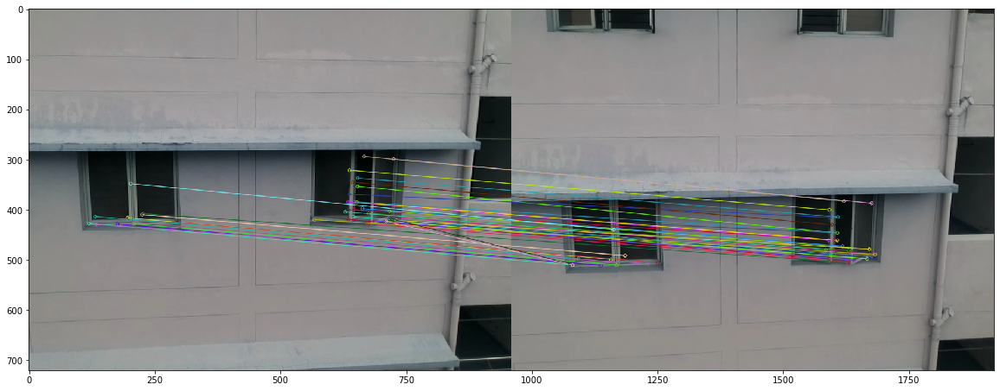

Final homography:  [[ 9.54788695e-01 -3.05379666e-02  1.45992495e+01]
 [-1.70811257e-02  7.98455269e-01  1.52937577e+02]
 [-2.21140241e-06 -7.94010892e-05  1.00000000e+00]]
Final inliers count:  31
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


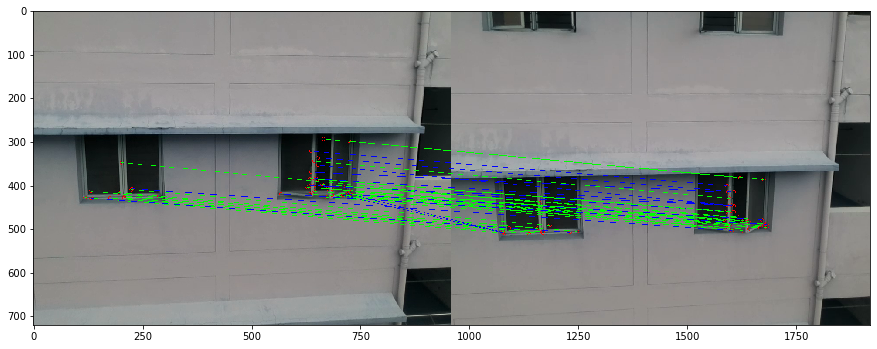

[[225.60447692871094, 409.4723205566406, 225.63638305664062, 491.303466796875], [663.4976196289062, 397.5752258300781, 658.4896850585938, 472.44342041015625], [635.006591796875, 384.526611328125, 630.575927734375, 460.5771484375], [225.60447692871094, 409.4723205566406, 225.63638305664062, 491.303466796875], [196.56704711914062, 416.08782958984375, 197.63893127441406, 498.6506042480469], [686.9434204101562, 408.6240234375, 681.68505859375, 482.7691650390625], [176.33599853515625, 428.4482116699219, 177.72830200195312, 510.6571044921875], [663.4976196289062, 397.5752258300781, 658.4896850585938, 472.44342041015625], [210.1217498779297, 424.7803955078125, 210.78822326660156, 506.4762268066406], [207.4530487060547, 424.66082763671875, 207.8412628173828, 506.44903564453125], [645.6310424804688, 413.82781982421875, 640.8035278320312, 488.94500732421875], [675.78857421875, 407.0847473144531, 670.0771484375, 480.9481201171875], [629.4580688476562, 404.2799377441406, 625.242431640625, 479.6978

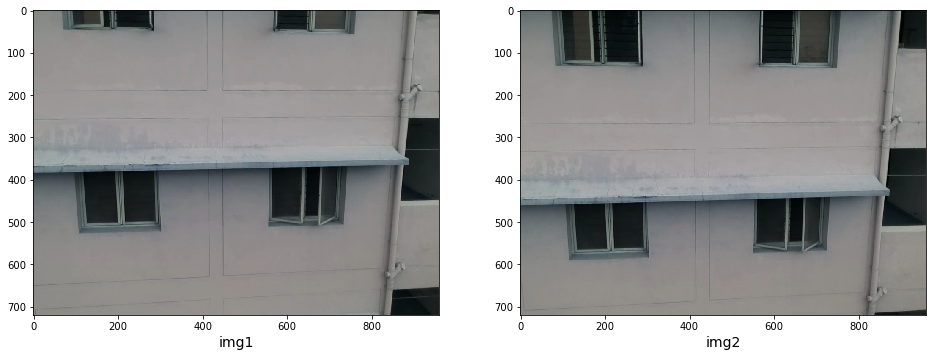

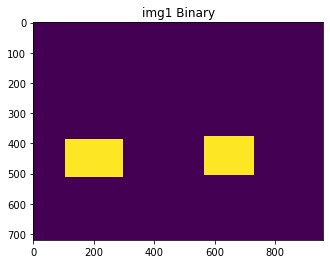

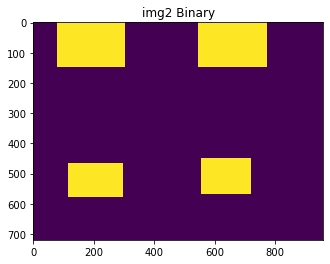

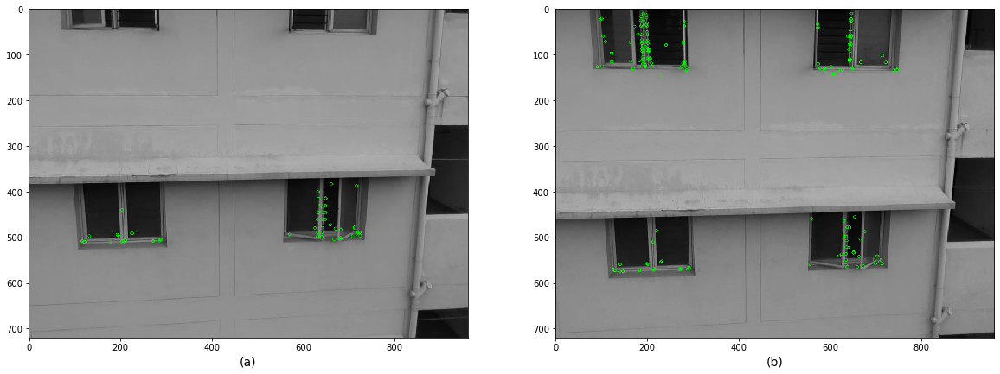

Using: bf feature matcher
Raw matches (Brute force): 47


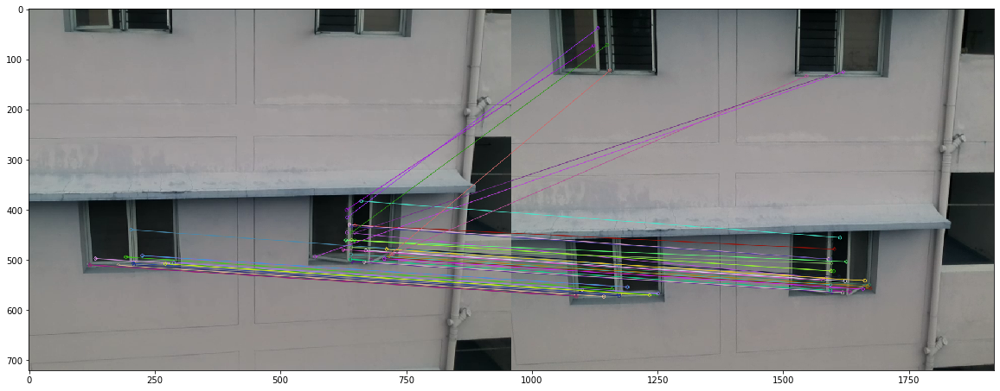

Final homography:  [[ 8.97110997e-01 -1.25972954e-02  3.12080912e+01]
 [-5.46135323e-02  8.87258366e-01  1.25592332e+02]
 [-9.69827924e-05  2.26762738e-05  1.00000000e+00]]
Final inliers count:  36
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


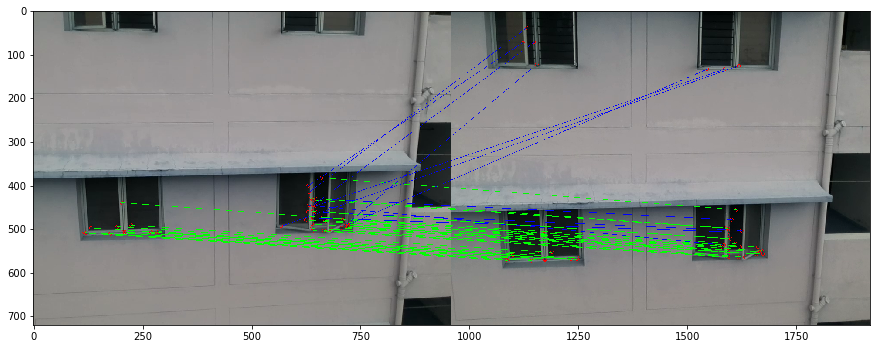

[[225.63638305664062, 491.303466796875, 230.42904663085938, 553.5982666015625], [225.63638305664062, 491.303466796875, 230.42904663085938, 553.5982666015625], [658.4896850585938, 472.44342041015625, 651.0100708007812, 533.1495971679688], [132.6862335205078, 497.1296081542969, 140.46299743652344, 559.2197265625], [723.8897094726562, 496.1434631347656, 714.3718872070312, 557.1448364257812], [210.78822326660156, 506.4762268066406, 215.8596649169922, 568.457275390625], [658.4896850585938, 472.44342041015625, 651.0100708007812, 533.1495971679688], [711.5595092773438, 478.5356750488281, 702.7848510742188, 541.0789184570312], [203.68246459960938, 439.6307067871094, 212.51885986328125, 510.4337463378906], [117.19795227050781, 507.7984313964844, 125.24769592285156, 570.0142211914062], [648.0077514648438, 460.6353759765625, 640.6035766601562, 522.1456909179688], [643.2401733398438, 503.3313903808594, 636.999267578125, 564.1072387695312], [209.23440551757812, 509.8338317871094, 214.189453125, 571

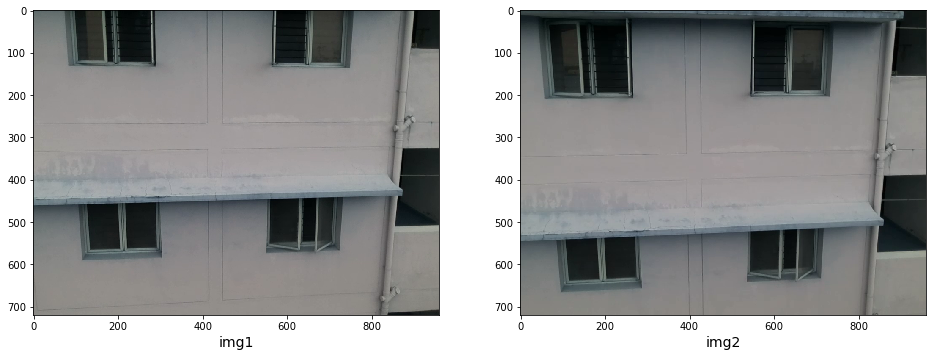

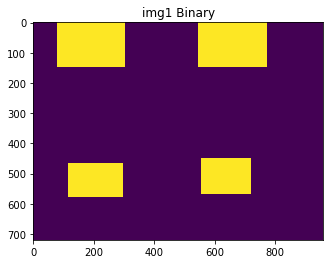

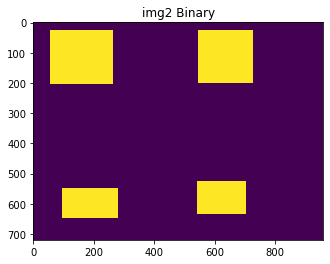

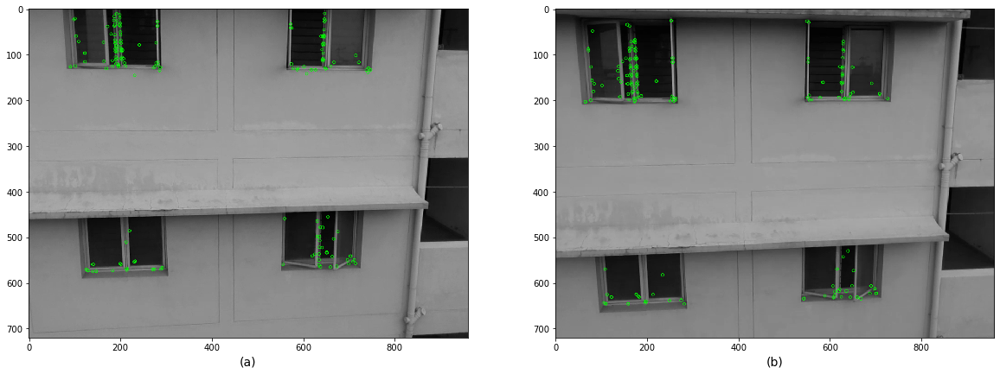

Using: bf feature matcher
Raw matches (Brute force): 110


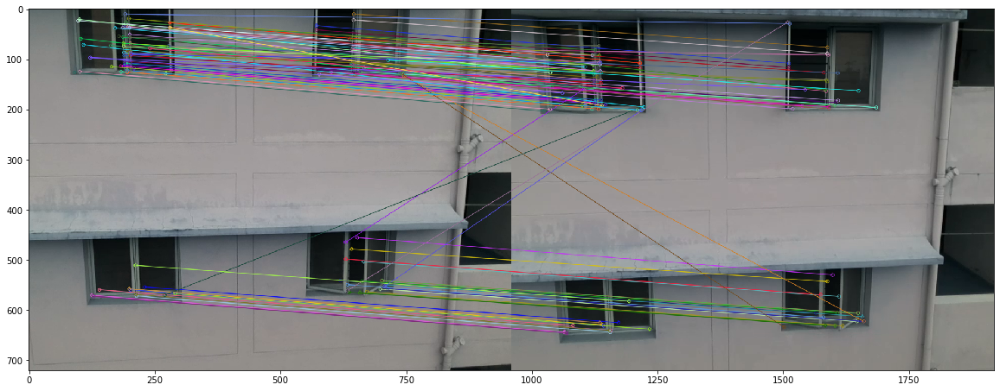

Final homography:  [[ 1.00243340e+00  1.10099228e-02 -2.57970337e+01]
 [-2.38068042e-02  9.92104981e-01  8.19350027e+01]
 [-1.44236511e-05  6.62432891e-06  1.00000000e+00]]
Final inliers count:  65
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


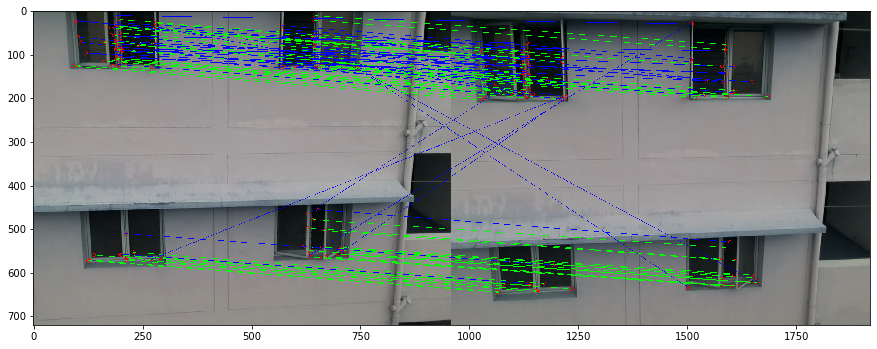

[[189.855712890625, 71.80950164794922, 165.83885192871094, 144.9140167236328], [230.42904663085938, 553.5982666015625, 212.77099609375, 624.4375610351562], [201.5804901123047, 68.90592956542969, 177.6188507080078, 142.08258056640625], [192.04930114746094, 108.07018280029297, 168.37852478027344, 180.8505401611328], [191.07476806640625, 89.66535186767578, 167.18719482421875, 162.96180725097656], [163.13128662109375, 72.91951751708984, 137.97393798828125, 152.9489288330078], [188.0997772216797, 34.61959457397461, 163.7218780517578, 108.04602813720703], [199.74403381347656, 557.5541381835938, 181.24681091308594, 629.32177734375], [201.5013885498047, 559.2887573242188, 182.7296905517578, 630.7298583984375], [187.48171997070312, 56.26095199584961, 163.29981994628906, 129.58938598632812], [189.13870239257812, 87.00701904296875, 165.05191040039062, 160.2898406982422], [665.9454956054688, 503.267333984375, 650.931640625, 572.5955810546875], [662.9000854492188, 541.819091796875, 647.841369628906

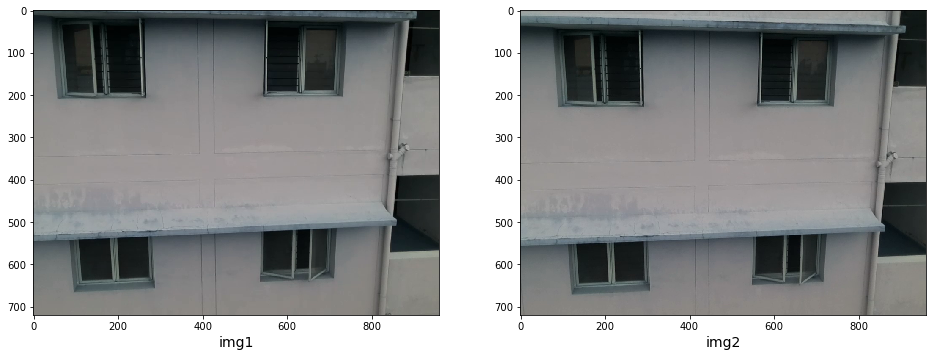

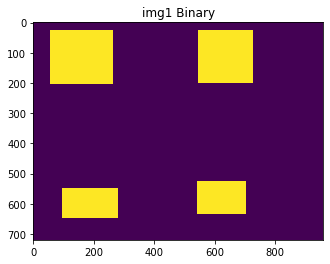

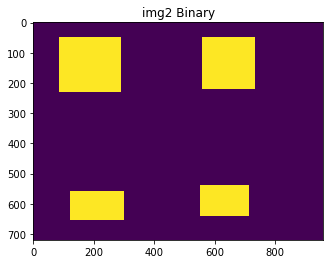

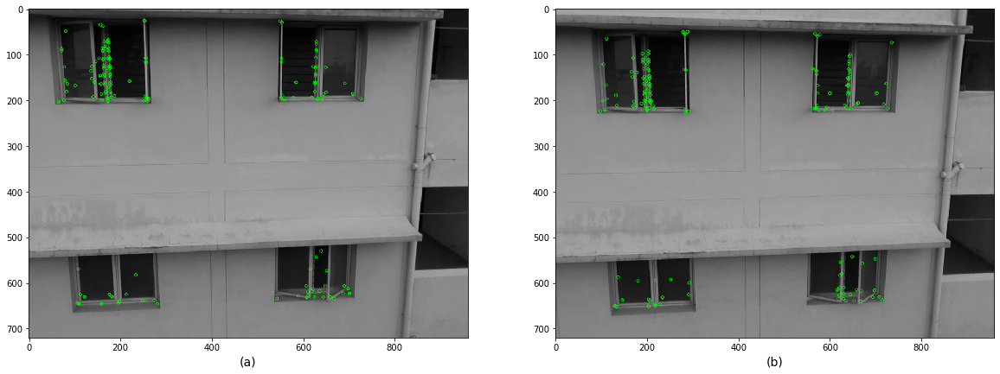

Using: bf feature matcher
Raw matches (Brute force): 122


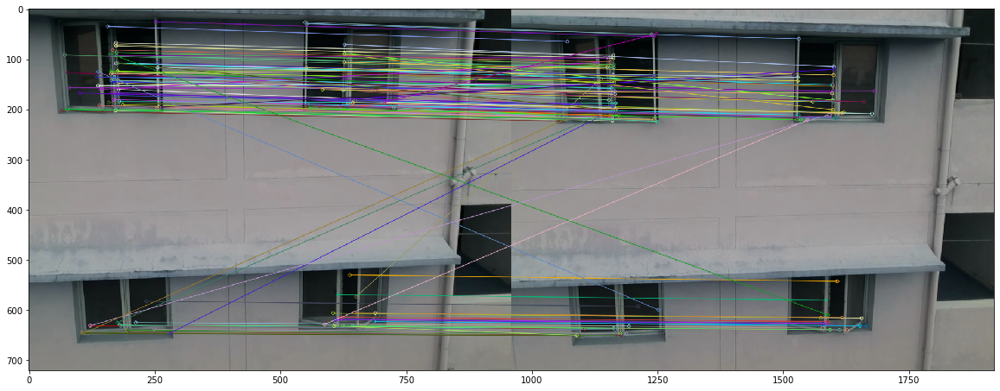

Final homography:  [[ 9.83950590e-01 -1.07411210e-02  3.31948941e+01]
 [ 1.30023925e-02  9.74466631e-01  2.38321073e+01]
 [ 1.58007819e-05  3.76222563e-06  1.00000000e+00]]
Final inliers count:  77
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


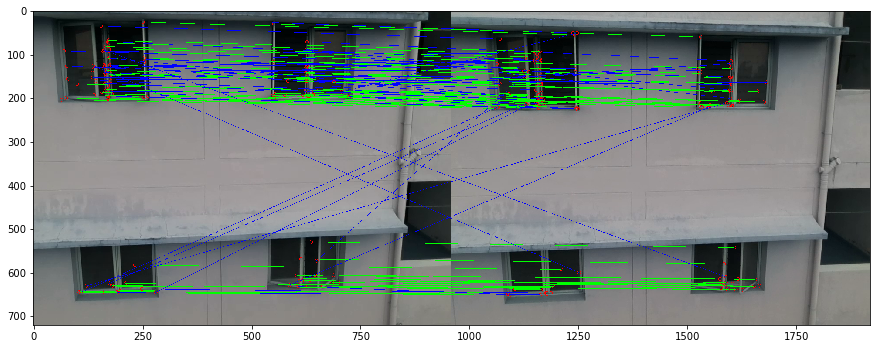

[[643.7236938476562, 630.730712890625, 652.4701538085938, 638.9703369140625], [689.1709594726562, 605.981689453125, 696.3521118164062, 615.9609375], [165.83885192871094, 144.9140167236328, 194.4800262451172, 166.8712921142578], [689.1709594726562, 605.981689453125, 696.3521118164062, 615.9609375], [65.12954711914062, 203.3688201904297, 97.73341369628906, 223.60784912109375], [181.24681091308594, 629.32177734375, 203.34979248046875, 636.062255859375], [578.1697387695312, 193.4498291015625, 592.7254638671875, 215.51365661621094], [605.4295654296875, 606.006103515625, 615.1117553710938, 614.9520263671875], [178.02102661132812, 147.95156860351562, 205.91741943359375, 169.7403564453125], [177.6188507080078, 142.08258056640625, 205.68446350097656, 164.0017852783203], [635.320556640625, 617.063720703125, 644.353759765625, 625.3944702148438], [627.8583984375, 143.91062927246094, 640.8033447265625, 167.97445678710938], [658.8290405273438, 630.7872924804688, 667.023681640625, 639.28662109375], [

In [51]:

# grab the paths to the input images and initialize our images list
print("[INFO] loading images...")
imagePaths = sorted(list(paths.list_images(imgPath)))
images = []
# loop over the image paths, load each one, and add them to our
# images to stitch list
for imagePath in imagePaths:
    image = cv2.imread(imagePath, 1)
#     print(image.shape)
    images.append(image)
    print(imagePath)
    
print(images[0].shape)

windowCount = len(FinalList[0])
print("startWindowCount:", windowCount)
## MAIN LOOP ##
for i in range(len(images) - 1):
    img1 = images[i]
    img2 = images[i+1]
    
#     print(img1.shape)
    # read images and transform them to grayscale
    # Make sure that the train image is the image that will be transformed
    # Opencv defines the color channel in the order BGR 
    # Transform it to RGB to be compatible to matplotlib
    img1_gray = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
    img2_gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
    ax1.imshow(img1, cmap="gray")
    ax1.set_xlabel("img1", fontsize=14)
    ax2.imshow(img2, cmap="gray")
    ax2.set_xlabel("img2", fontsize=14)
    plt.show()
    
    ## Preparing Binary Mask and mapping bounding box coordinates
    ## COORDS1 and COORDS2 : WOULD COME FROM TEXT FILE
#     coords1 = batch_data_int[i]
#     coords1 = np.array(coords1)
#     print(coords1)
#     coords1 = coords1.reshape(-1, 2)
#     coords1 = np.reshape(coords1,(coords1.shape[0]//4 , 4, coords1.shape[1]))
    
#     coords2 = batch_data_int[i+1]
#     coords2 = np.array(coords2)
#     coords2 = coords2.reshape(-1,2)
#     coords2 = np.reshape(coords2,(coords2.shape[0]//4 , 4, coords2.shape[1]))
    
    coords1 = FinalList[i]
    coords2 = FinalList[i+1]
#     print(coords1)
    
    padding = 0
    img1_binary = prepareBinaryMask(img1_gray, coords1, padding)
    img2_binary = prepareBinaryMask(img2_gray, coords2, padding)
    plt.figure()
    plt.title('img1 Binary')
    plt.imshow(img1_binary)
    plt.show()
    plt.title('img2 Binary')
    plt.imshow(img2_binary)
    plt.show()

    ## Commented as the coords would come from recorded text File.
    ## LEFT TO DO
#     print("coords1:", coords1)
    pick1 = mapToPickv1(coords1, padding)
    pick2 = mapToPickv1(coords2, padding)
#     print("pick1:", pick1)
        
    kpsA, featuresA = detectAndDescribe(img1_gray, img1_binary, method=feature_extractor)
    kpsB, featuresB = detectAndDescribe(img2_gray, img2_binary, method=feature_extractor)
#     print('featuresA: ')
#     print(featuresA)
#     print('featuresB: ')
#     print(featuresB)
#     print((kpsA))
#     print(kpsB)
#     kpsA_dummy = np.float32([kp.pt for kp in kpsA])
#     print("kpsA: ", kpsA_dummy)
    
    # display the keypoints and features detected on both images
    fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
    ax1.imshow(cv2.drawKeypoints(img1_gray,kpsA,None,color=(0,255,0)))
    ax1.set_xlabel("(a)", fontsize=14)
    ax2.imshow(cv2.drawKeypoints(img2_gray,kpsB,None,color=(0,255,0)))
    ax2.set_xlabel("(b)", fontsize=14)
    plt.show()
    
    # Match Feature Points
    print("Using: {} feature matcher".format(feature_matching))
    fig = plt.figure(figsize=(20,8))
    if feature_matching == 'bf':
        matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
        img3 = cv2.drawMatches(img1,kpsA,img2,kpsB,matches,
                               None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    elif feature_matching == 'knn':
        matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)
        img3 = cv2.drawMatches(img1,kpsA,img2,kpsB,np.random.choice(matches,100),
                               None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img3)
    plt.show()
    
    ## Calculating homography and rejecting outliers
    correspondenceList = []
    estimation_thresh = 0.75
    for match in matches:
        (x1, y1) = kpsA[match.queryIdx].pt
        (x2, y2) = kpsB[match.trainIdx].pt
        correspondenceList.append([x1, y1, x2, y2])

    corrs = np.matrix(correspondenceList)
#     print("Correspondences:", corrs)
    #run ransac algorithm
    finalH, inliers = ransac(corrs, estimation_thresh)
    print("Final homography: ", finalH)
    print("Final inliers count: ", len(inliers))
#     print("Inliers: " +  str(inliers))
    img3 = drawMatches(img1,kpsA,img2,kpsB, matches, inliers)
    plt.figure(figsize=(15,15))
    plt.imshow(img3)
    plt.show()

    ## Converting to numpy array = INLIERS
    inliers_Arr = np.array(inliers)
    inliers = np.squeeze(inliers_Arr, axis = 1).tolist()
    print(inliers)
    
    print("pick1:", pick1)
    print("pick2:", pick2)
    newWindows, newWindowsCount = calculateUnMatchedWindows(inliers, pick1, pick2)
    windowCount += newWindowsCount

print('Total windows are:', windowCount)